In [1]:
import tensorflow as tf
import numpy as np
import datetime
import matplotlib.pyplot as plt
%matplotlib inline

from tensorflow.examples.tutorials.mnist import input_data
mnist = input_data.read_data_sets("MNIST_data/")

Extracting MNIST_data/train-images-idx3-ubyte.gz
Extracting MNIST_data/train-labels-idx1-ubyte.gz
Extracting MNIST_data/t10k-images-idx3-ubyte.gz
Extracting MNIST_data/t10k-labels-idx1-ubyte.gz


(128, 128)


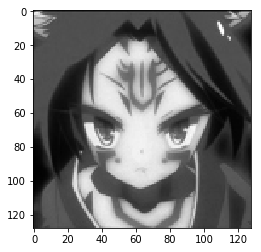

In [2]:
img_width = 128
img_height = 128

sample_image = plt.imread('./XD.png')     

print(sample_image.shape)

sample_image = sample_image.reshape([img_height, img_width])
plt.imshow(sample_image, cmap="gray")

In [3]:
def discriminator(images, reuse_variables=None):
    with tf.variable_scope(tf.get_variable_scope(), reuse=reuse_variables) as scope:
        # First convolutional and pool layers
        # This finds 32 different 5 x 5 pixel features
        d_w1 = tf.get_variable('d_w1', [5, 5, 1, 32], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b1 = tf.get_variable('d_b1', [32], initializer=tf.constant_initializer(0))
        d1 = tf.nn.conv2d(input=images, filter=d_w1, strides=[1, 1, 1, 1], padding='SAME')
        d1 = d1 + d_b1
        d1 = tf.nn.relu(d1)
        d1 = tf.nn.avg_pool(d1, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME')

        # Second convolutional and pool layers
        # This finds 64 different 5 x 5 pixel features
        d_w2 = tf.get_variable('d_w2', [5, 5, 32, 64], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b2 = tf.get_variable('d_b2', [64], initializer=tf.constant_initializer(0))
        d2 = tf.nn.conv2d(input=d1, filter=d_w2, strides=[1, 1, 1, 1], padding='SAME')
        d2 = d2 + d_b2
        d2 = tf.nn.relu(d2)
        d2 = tf.nn.avg_pool(d2, ksize=[1, 2, 2, 1], strides=[1, 2, 2, 1], padding='SAME')

        # First fully connected layer
        d_w3 = tf.get_variable('d_w3', [int((img_height/4) * (img_width/4) * 64), 1024], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b3 = tf.get_variable('d_b3', [1024], initializer=tf.constant_initializer(0))
        d3 = tf.reshape(d2, [-1, int((img_height/4) * (img_width/4) * 64)])
        d3 = tf.matmul(d3, d_w3)
        d3 = d3 + d_b3
        d3 = tf.nn.relu(d3)

        # Second fully connected layer
        d_w4 = tf.get_variable('d_w4', [1024, 1], initializer=tf.truncated_normal_initializer(stddev=0.02))
        d_b4 = tf.get_variable('d_b4', [1], initializer=tf.constant_initializer(0))
        d4 = tf.matmul(d3, d_w4) + d_b4

        # d4 contains unscaled values
        return d4

In [4]:
def generator(z, batch_size, z_dim):
    g_w1 = tf.get_variable('g_w1', [z_dim, int((img_height/4) * (img_width/4) * 64)], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b1 = tf.get_variable('g_b1', [int((img_height/4) * (img_width/4) * 64)], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g1 = tf.matmul(z, g_w1) + g_b1
    g1 = tf.reshape(g1, [-1, img_height*2, img_width*2, 1])
    g1 = tf.contrib.layers.batch_norm(g1, epsilon=1e-5, scope='bn1')
    g1 = tf.nn.relu(g1)

    # Generate 50 features
    g_w2 = tf.get_variable('g_w2', [3, 3, 1, z_dim/2], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b2 = tf.get_variable('g_b2', [z_dim/2], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g2 = tf.nn.conv2d(g1, g_w2, strides=[1, 2, 2, 1], padding='SAME')
    g2 = g2 + g_b2
    g2 = tf.contrib.layers.batch_norm(g2, epsilon=1e-5, scope='bn2')
    g2 = tf.nn.relu(g2)
    g2 = tf.image.resize_images(g2, [img_height*2, img_width*2])

    # Generate 25 features
    g_w3 = tf.get_variable('g_w3', [3, 3, z_dim/2, z_dim/4], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b3 = tf.get_variable('g_b3', [z_dim/4], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g3 = tf.nn.conv2d(g2, g_w3, strides=[1, 2, 2, 1], padding='SAME')
    g3 = g3 + g_b3
    g3 = tf.contrib.layers.batch_norm(g3, epsilon=1e-5, scope='bn3')
    g3 = tf.nn.relu(g3)
    g3 = tf.image.resize_images(g3, [img_height*2, img_width*2])

    # Final convolution with one output channel
    g_w4 = tf.get_variable('g_w4', [1, 1, z_dim/4, 1], dtype=tf.float32, initializer=tf.truncated_normal_initializer(stddev=0.02))
    g_b4 = tf.get_variable('g_b4', [1], initializer=tf.truncated_normal_initializer(stddev=0.02))
    g4 = tf.nn.conv2d(g3, g_w4, strides=[1, 2, 2, 1], padding='SAME')
    g4 = g4 + g_b4
    g4 = tf.sigmoid(g4)
    
    # Dimensions of g4: batch_size x 7 x 112 x 1
    return g4

In [5]:
z_dimensions = 100
z_placeholder = tf.placeholder(tf.float32, [None, z_dimensions])

In [6]:
generated_image_output = generator(z_placeholder, 1, z_dimensions)
z_batch = np.random.normal(0, 1, [1, z_dimensions])

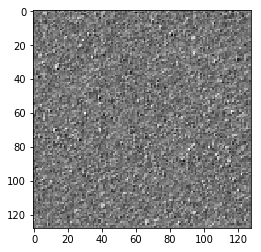

In [7]:
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    generated_image = sess.run(generated_image_output,
                                feed_dict={z_placeholder: z_batch})
    generated_image = generated_image.reshape([img_height, img_width])
    plt.imshow(generated_image, cmap="gray")

In [15]:
tf.reset_default_graph()
batch_size = 1

z_placeholder = tf.placeholder(tf.float32, [None, z_dimensions], name='z_placeholder') 
# z_placeholder is for feeding input noise to the generator

x_placeholder = tf.placeholder(tf.float32, shape = [None,img_height,img_width,1], name='x_placeholder') 
# x_placeholder is for feeding input images to the discriminator

Gz = generator(z_placeholder, batch_size, z_dimensions) 
# Gz holds the generated images

Dx = discriminator(x_placeholder) 
# Dx will hold discriminator prediction probabilities
# for the real MNIST images

Dg = discriminator(Gz, reuse_variables=True)
# Dg will hold discriminator prediction probabilities for generated images

In [16]:
d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = Dx, labels = tf.ones_like(Dx)))
d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = Dg, labels = tf.zeros_like(Dg)))

In [17]:
g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = Dg, labels = tf.ones_like(Dg)))

In [18]:
tvars = tf.trainable_variables()

d_vars = [var for var in tvars if 'd_' in var.name]
g_vars = [var for var in tvars if 'g_' in var.name]

print([v.name for v in d_vars])
print([v.name for v in g_vars])

['d_w1:0', 'd_b1:0', 'd_w2:0', 'd_b2:0', 'd_w3:0', 'd_b3:0', 'd_w4:0', 'd_b4:0']
['g_w1:0', 'g_b1:0', 'g_w2:0', 'g_b2:0', 'g_w3:0', 'g_b3:0', 'g_w4:0', 'g_b4:0']


In [19]:
# Train the discriminator
d_trainer_fake = tf.train.AdamOptimizer(0.0003).minimize(d_loss_fake, var_list=d_vars)
d_trainer_real = tf.train.AdamOptimizer(0.0003).minimize(d_loss_real, var_list=d_vars)

# Train the generator
g_trainer = tf.train.AdamOptimizer(0.0001).minimize(g_loss, var_list=g_vars)

In [20]:
# From this point forward, reuse variables
tf.get_variable_scope().reuse_variables()

tf.summary.scalar('Generator_loss', g_loss)
tf.summary.scalar('Discriminator_loss_real', d_loss_real)
tf.summary.scalar('Discriminator_loss_fake', d_loss_fake)

images_for_tensorboard = generator(z_placeholder, batch_size, z_dimensions)
tf.summary.image('Generated_images', images_for_tensorboard, 5)
merged = tf.summary.merge_all()
logdir = "tensorboard/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + "/"
writer = tf.summary.FileWriter(logdir, sess.graph)

dLossReal: 0.702097 dLossFake: 0.688257
dLossReal: 0.0065364 dLossFake: 3.19121e-06
dLossReal: 2.2045e-05 dLossFake: 1.25551e-06
Iteration: 0 at 2018-01-08 21:32:13.125936


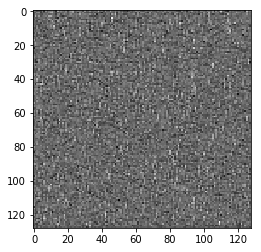

Estimate: [[-12.32693386]]
Iteration: 100 at 2018-01-08 21:34:07.404968


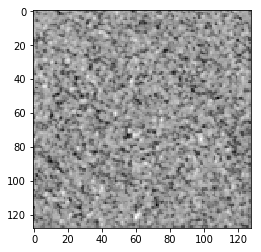

Estimate: [[-10.54070091]]
Iteration: 200 at 2018-01-08 21:36:00.544822


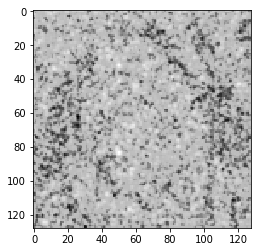

Estimate: [[-9.47044563]]
Iteration: 300 at 2018-01-08 21:37:54.321448


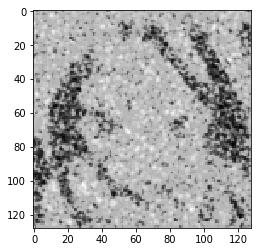

Estimate: [[-7.51165915]]
Iteration: 400 at 2018-01-08 21:39:48.495664


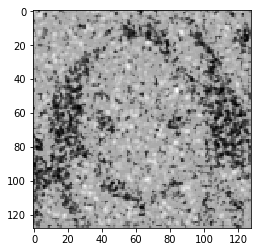

Estimate: [[-9.35875893]]
Iteration: 500 at 2018-01-08 21:41:42.163626


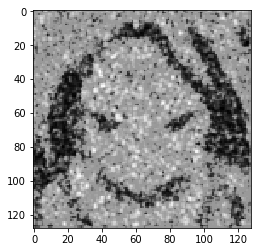

Estimate: [[-6.5265975]]
Iteration: 600 at 2018-01-08 21:43:35.848078


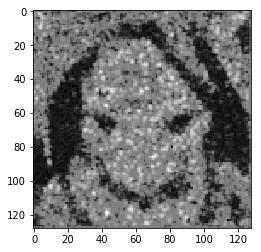

Estimate: [[-36.08122635]]
Iteration: 700 at 2018-01-08 21:45:30.095309


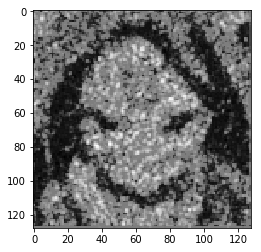

Estimate: [[-14.75080776]]
Iteration: 800 at 2018-01-08 21:47:23.598849


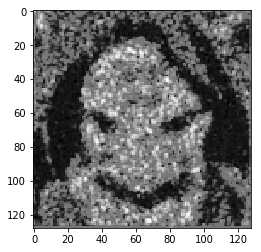

Estimate: [[ 5.91902781]]
Iteration: 900 at 2018-01-08 21:49:17.474968


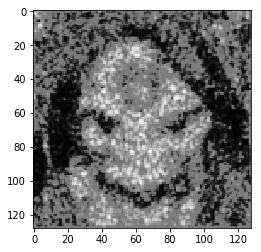

Estimate: [[ 4.45822144]]
Iteration: 1000 at 2018-01-08 21:51:11.227653


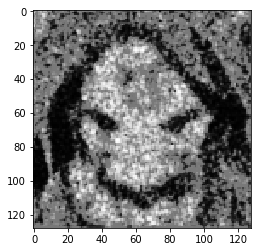

Estimate: [[ 8.33956909]]
Iteration: 1100 at 2018-01-08 21:53:04.474850


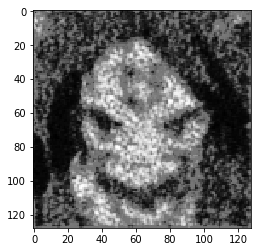

Estimate: [[-14.48001194]]
Iteration: 1200 at 2018-01-08 21:54:58.894328


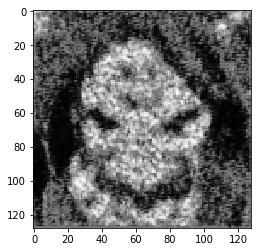

Estimate: [[-31.38340378]]
Iteration: 1300 at 2018-01-08 21:56:53.311192


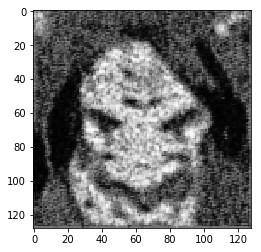

Estimate: [[ 5.66891384]]
Iteration: 1400 at 2018-01-08 21:58:47.793272


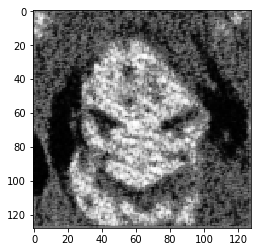

Estimate: [[-5.53139877]]
Iteration: 1500 at 2018-01-08 22:00:41.393623


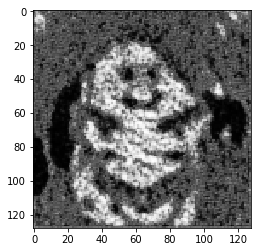

Estimate: [[-21.24580383]]
Iteration: 1600 at 2018-01-08 22:02:35.634245


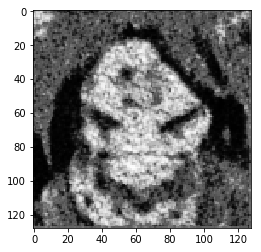

Estimate: [[ 37.85480499]]
Iteration: 1700 at 2018-01-08 22:04:30.161723


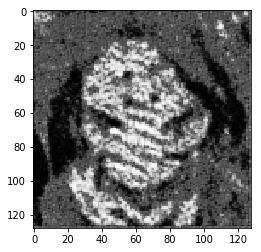

Estimate: [[-10.61973286]]
Iteration: 1800 at 2018-01-08 22:06:24.574067


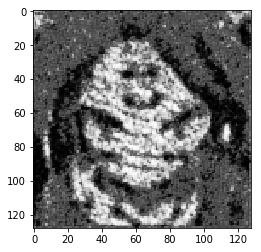

Estimate: [[-29.00500488]]
Iteration: 1900 at 2018-01-08 22:08:18.894268


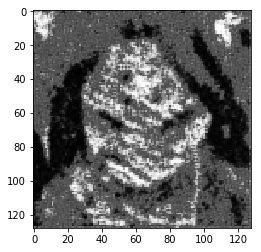

Estimate: [[-18.18122482]]
Iteration: 2000 at 2018-01-08 22:10:14.319359


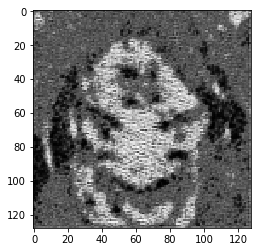

Estimate: [[-40.88150024]]
Iteration: 2100 at 2018-01-08 22:12:07.775293


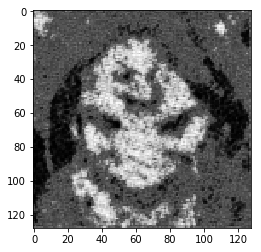

Estimate: [[-6.81312275]]
Iteration: 2200 at 2018-01-08 22:14:01.168929


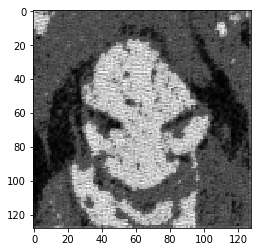

Estimate: [[-16.69777679]]
Iteration: 2300 at 2018-01-08 22:15:54.313347


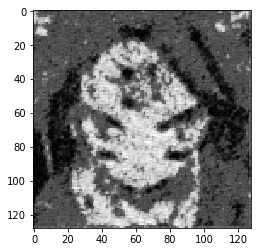

Estimate: [[-5.37447166]]
Iteration: 2400 at 2018-01-08 22:17:47.091858


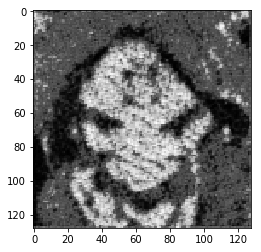

Estimate: [[ 8.397192]]
Iteration: 2500 at 2018-01-08 22:19:41.097457


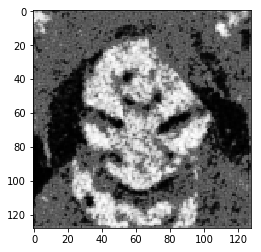

Estimate: [[-23.55496407]]
Iteration: 2600 at 2018-01-08 22:21:34.050004


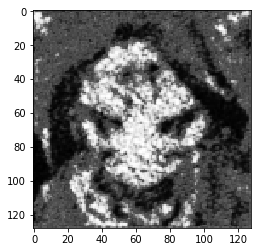

Estimate: [[-0.16642623]]
Iteration: 2700 at 2018-01-08 22:23:27.772011


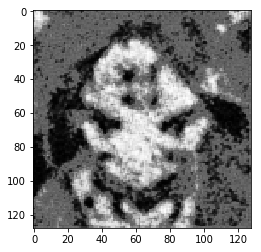

Estimate: [[-28.41810608]]
Iteration: 2800 at 2018-01-08 22:25:20.335868


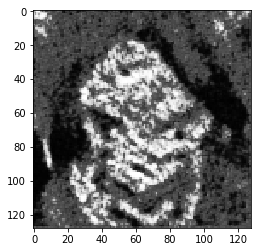

Estimate: [[-17.01786804]]
Iteration: 2900 at 2018-01-08 22:27:13.931153


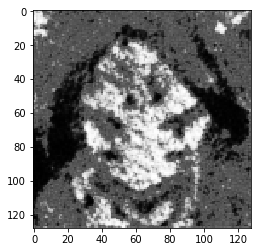

Estimate: [[-64.43378448]]
Iteration: 3000 at 2018-01-08 22:29:07.539244


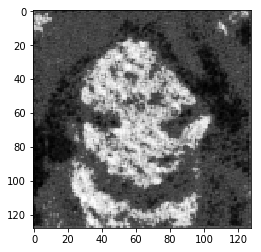

Estimate: [[-12.11991882]]
Iteration: 3100 at 2018-01-08 22:31:00.738005


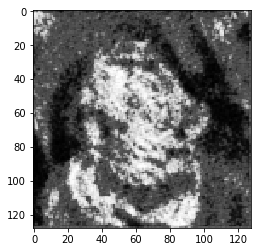

Estimate: [[-56.18152618]]
Iteration: 3200 at 2018-01-08 22:32:53.700008


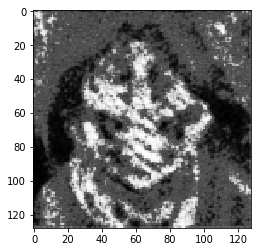

Estimate: [[-40.3589859]]
Iteration: 3300 at 2018-01-08 22:34:46.456215


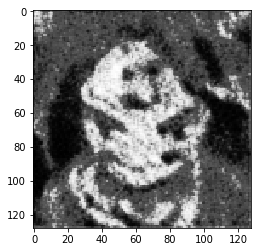

Estimate: [[-52.8151741]]
Iteration: 3400 at 2018-01-08 22:36:39.827748


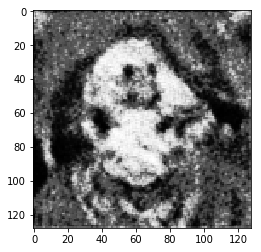

Estimate: [[-56.46700287]]
Iteration: 3500 at 2018-01-08 22:38:33.019323


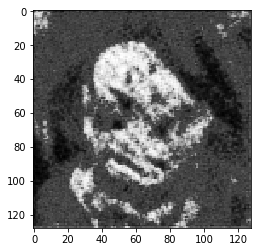

Estimate: [[-15.70086956]]
Iteration: 3600 at 2018-01-08 22:40:25.863559


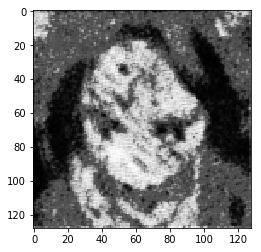

Estimate: [[-18.90440941]]
Iteration: 3700 at 2018-01-08 22:42:17.988309


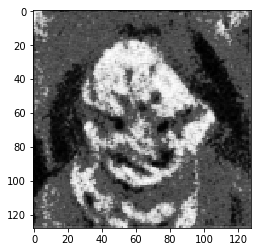

Estimate: [[-25.2786808]]
Iteration: 3800 at 2018-01-08 22:44:11.415409


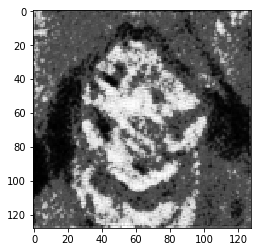

Estimate: [[-44.66717911]]
Iteration: 3900 at 2018-01-08 22:46:05.781125


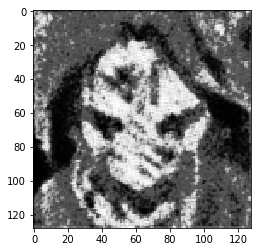

Estimate: [[-18.25361061]]
Iteration: 4000 at 2018-01-08 22:47:59.295660


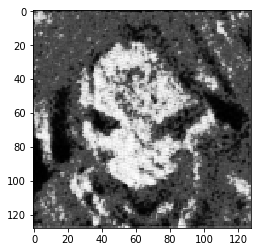

Estimate: [[-22.12617493]]
Iteration: 4100 at 2018-01-08 22:49:52.522690


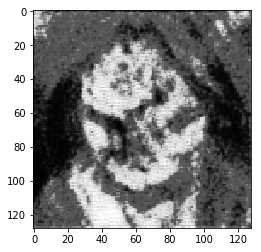

Estimate: [[-18.48267174]]
Iteration: 4200 at 2018-01-08 22:51:47.289754


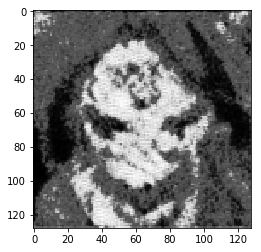

Estimate: [[-9.53994751]]
Iteration: 4300 at 2018-01-08 22:53:39.790618


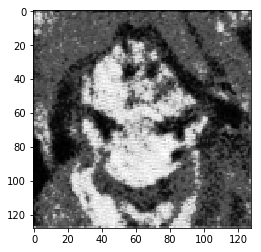

Estimate: [[-20.14803123]]
Iteration: 4400 at 2018-01-08 22:55:33.977341


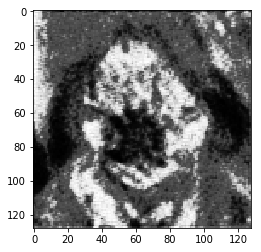

Estimate: [[-41.37382126]]
Iteration: 4500 at 2018-01-08 22:57:26.501858


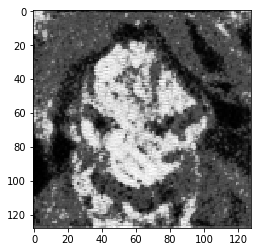

Estimate: [[-20.36312485]]
Iteration: 4600 at 2018-01-08 22:59:19.490369


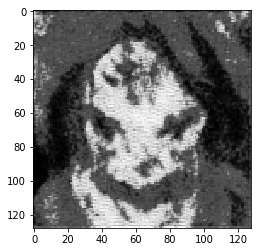

Estimate: [[ 3.98752975]]
Iteration: 4700 at 2018-01-08 23:01:13.372116


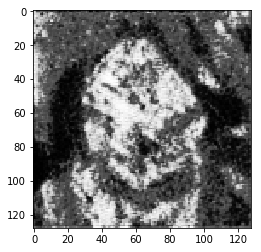

Estimate: [[ 12.06316853]]
Iteration: 4800 at 2018-01-08 23:03:07.097855


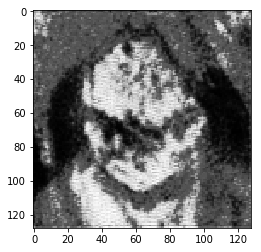

Estimate: [[-20.9173069]]
Iteration: 4900 at 2018-01-08 23:05:00.617653


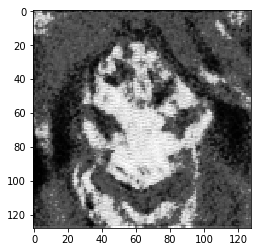

Estimate: [[-19.01749992]]
Iteration: 5000 at 2018-01-08 23:06:55.090216


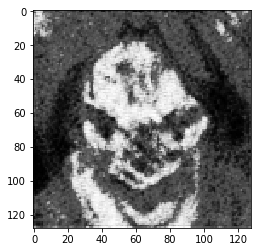

Estimate: [[-36.25392914]]
Iteration: 5100 at 2018-01-08 23:08:47.599474


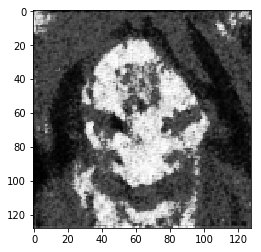

Estimate: [[-11.01750278]]
Iteration: 5200 at 2018-01-08 23:10:41.209662


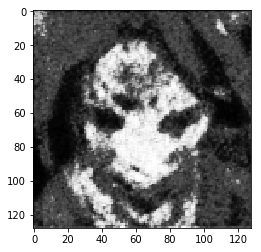

Estimate: [[ 18.20933533]]
Iteration: 5300 at 2018-01-08 23:12:34.945711


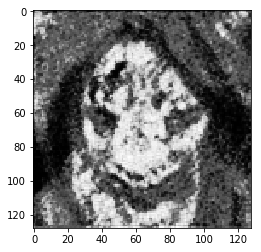

Estimate: [[-32.5642128]]
Iteration: 5400 at 2018-01-08 23:14:28.654248


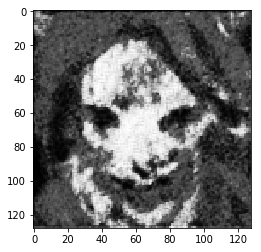

Estimate: [[-6.96469259]]
Iteration: 5500 at 2018-01-08 23:16:21.379023


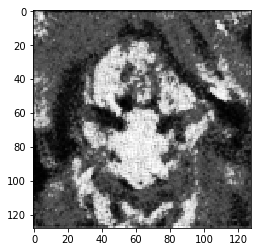

Estimate: [[-12.22199249]]
Iteration: 5600 at 2018-01-08 23:18:14.897327


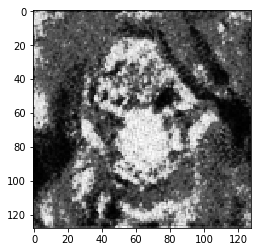

Estimate: [[-28.37249184]]
Iteration: 5700 at 2018-01-08 23:20:08.515327


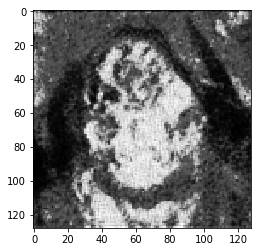

Estimate: [[ 31.78677177]]
Iteration: 5800 at 2018-01-08 23:22:02.309970


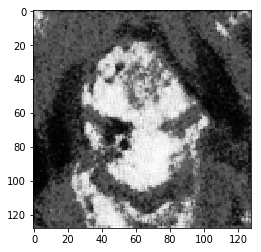

Estimate: [[ 90.54521179]]
Iteration: 5900 at 2018-01-08 23:23:56.095481


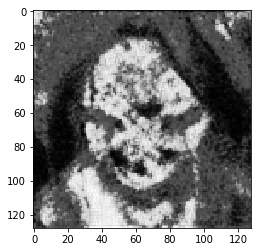

Estimate: [[-100.47080994]]
Iteration: 6000 at 2018-01-08 23:25:49.057941


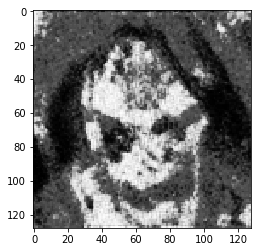

Estimate: [[ 9.93414116]]
Iteration: 6100 at 2018-01-08 23:27:42.559857


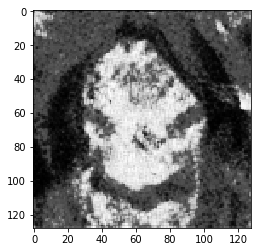

Estimate: [[-52.52563095]]
Iteration: 6200 at 2018-01-08 23:29:36.842712


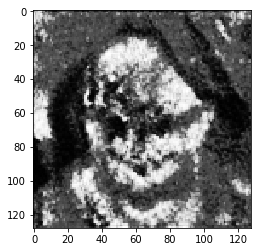

Estimate: [[-29.11302376]]
Iteration: 6300 at 2018-01-08 23:31:30.229602


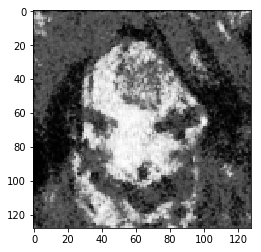

Estimate: [[-4.78156805]]
Iteration: 6400 at 2018-01-08 23:33:24.715898


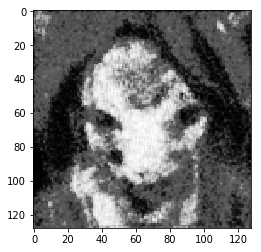

Estimate: [[-1.62381482]]
Iteration: 6500 at 2018-01-08 23:35:18.228253


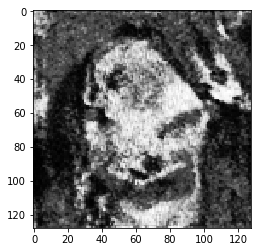

Estimate: [[ 25.931036]]
Iteration: 6600 at 2018-01-08 23:37:12.340605


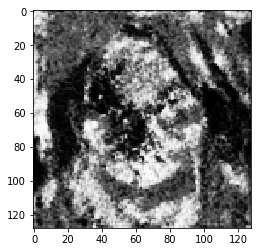

Estimate: [[-31.36862564]]
Iteration: 6700 at 2018-01-08 23:39:06.591555


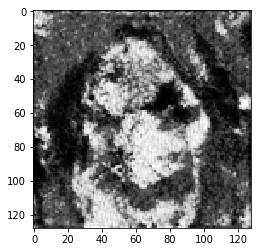

Estimate: [[-65.150177]]
Iteration: 6800 at 2018-01-08 23:40:59.960151


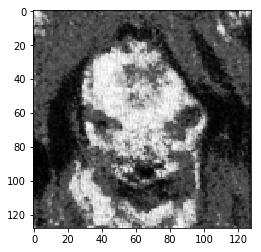

Estimate: [[ 2.86645031]]
Iteration: 6900 at 2018-01-08 23:42:53.359054


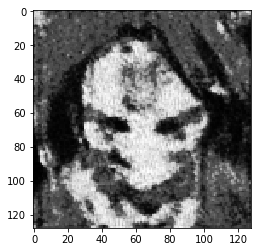

Estimate: [[-21.89593124]]
Iteration: 7000 at 2018-01-08 23:44:46.771498


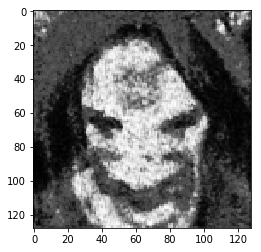

Estimate: [[ 2.40892768]]
Iteration: 7100 at 2018-01-08 23:46:40.754502


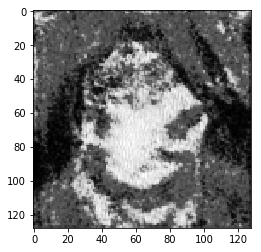

Estimate: [[-1.82253861]]
Iteration: 7200 at 2018-01-08 23:48:34.875373


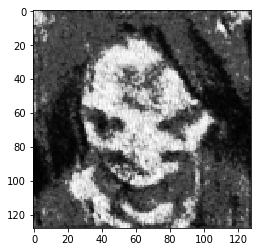

Estimate: [[-60.06326675]]
Iteration: 7300 at 2018-01-08 23:50:29.226328


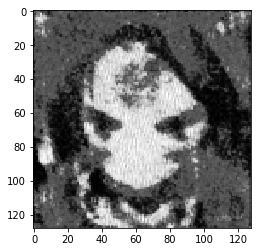

Estimate: [[ 28.09832382]]
Iteration: 7400 at 2018-01-08 23:52:23.363154


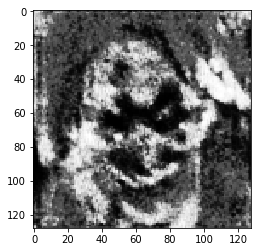

Estimate: [[ 7.01763678]]
Iteration: 7500 at 2018-01-08 23:54:17.196566


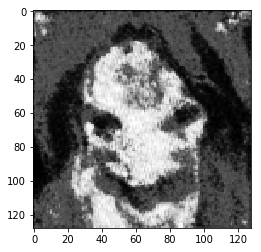

Estimate: [[ 36.92797852]]
Iteration: 7600 at 2018-01-08 23:56:11.084553


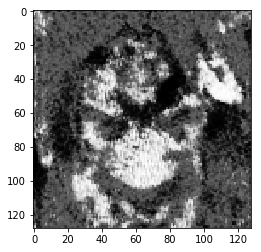

Estimate: [[-87.22283173]]
Iteration: 7700 at 2018-01-08 23:58:04.679885


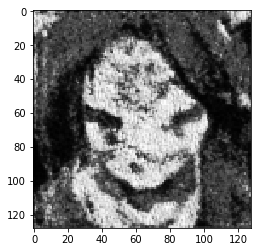

Estimate: [[-7.65003729]]
Iteration: 7800 at 2018-01-08 23:59:58.236222


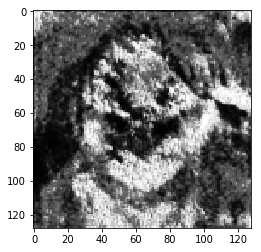

Estimate: [[-16.23510742]]
Iteration: 7900 at 2018-01-09 00:01:51.764585


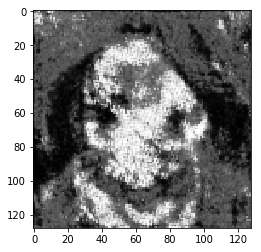

Estimate: [[-10.25752354]]
Iteration: 8000 at 2018-01-09 00:03:45.324271


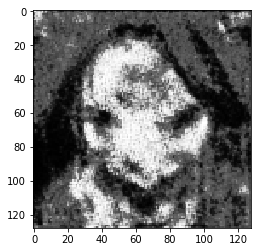

Estimate: [[-71.33716583]]
Iteration: 8100 at 2018-01-09 00:05:39.691956


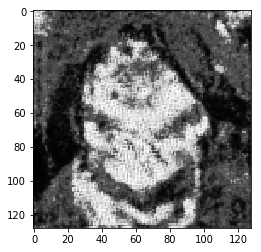

Estimate: [[ 10.33547688]]
Iteration: 8200 at 2018-01-09 00:07:32.896138


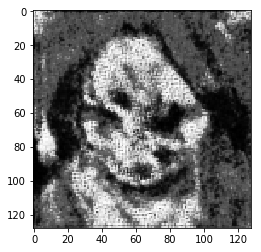

Estimate: [[-6.71678352]]
Iteration: 8300 at 2018-01-09 00:09:28.297962


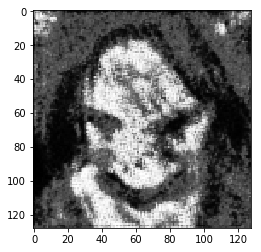

Estimate: [[-2.95253682]]
Iteration: 8400 at 2018-01-09 00:11:22.838110


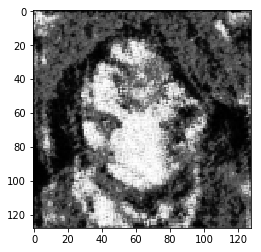

Estimate: [[-25.37609863]]
Iteration: 8500 at 2018-01-09 00:13:16.097933


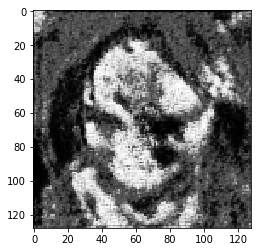

Estimate: [[ 9.94890308]]
Iteration: 8600 at 2018-01-09 00:15:11.793075


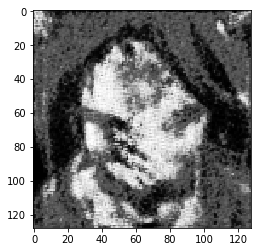

Estimate: [[-20.60484123]]
Iteration: 8700 at 2018-01-09 00:17:05.374395


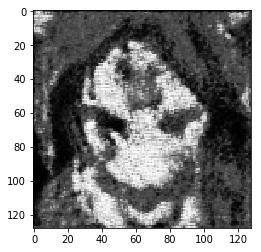

Estimate: [[ 25.48624229]]
Iteration: 8800 at 2018-01-09 00:19:00.002462


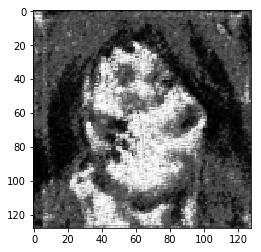

Estimate: [[ 7.71465254]]
Iteration: 8900 at 2018-01-09 00:20:53.392386


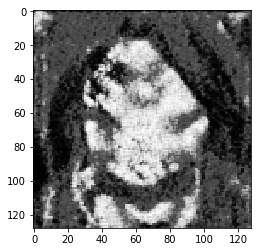

Estimate: [[-47.04014206]]
Iteration: 9000 at 2018-01-09 00:22:47.739154


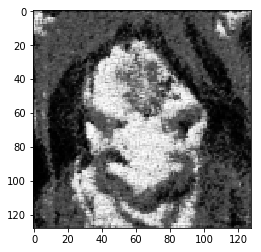

Estimate: [[-25.00011826]]
Iteration: 9100 at 2018-01-09 00:24:40.357322


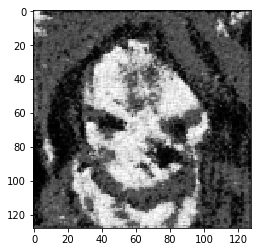

Estimate: [[-2.86920738]]
Iteration: 9200 at 2018-01-09 00:26:33.973443


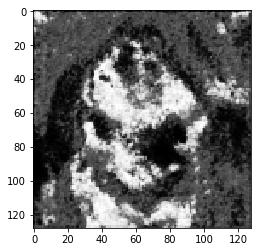

Estimate: [[-65.37352753]]
Iteration: 9300 at 2018-01-09 00:28:28.948113


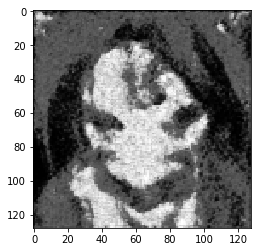

Estimate: [[ 5.80017376]]
Iteration: 9400 at 2018-01-09 00:30:22.510125


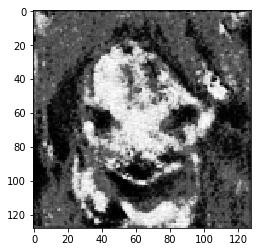

Estimate: [[-38.35462189]]
Iteration: 9500 at 2018-01-09 00:32:18.551774


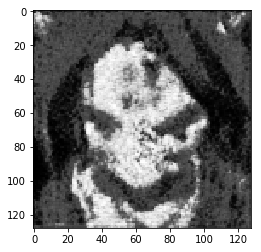

Estimate: [[ 3.86996913]]
Iteration: 9600 at 2018-01-09 00:34:13.239885


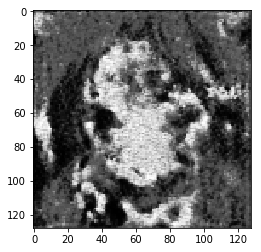

Estimate: [[-31.55672455]]
Iteration: 9700 at 2018-01-09 00:36:06.318669


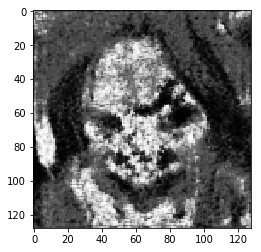

Estimate: [[-15.4503336]]
Iteration: 9800 at 2018-01-09 00:38:01.376572


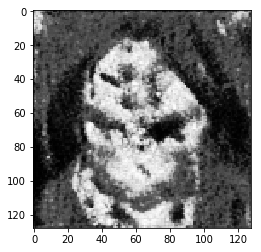

Estimate: [[-2.73525333]]
Iteration: 9900 at 2018-01-09 00:39:55.133653


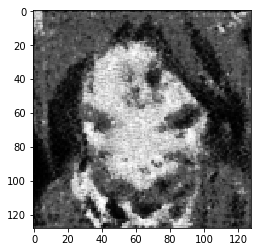

Estimate: [[-31.2638073]]
Iteration: 10000 at 2018-01-09 00:41:49.417664


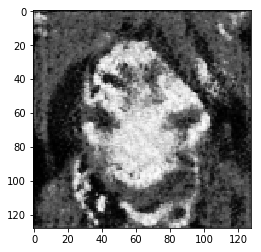

Estimate: [[-12.3061018]]
Iteration: 10100 at 2018-01-09 00:43:43.018721


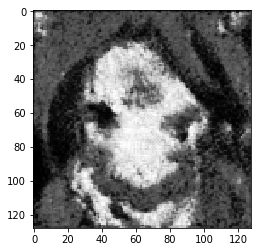

Estimate: [[-17.13108826]]
Iteration: 10200 at 2018-01-09 00:45:37.109140


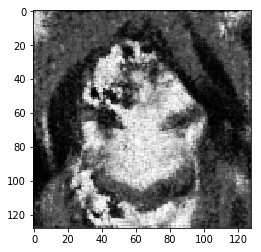

Estimate: [[-6.91140413]]
Iteration: 10300 at 2018-01-09 00:47:32.368256


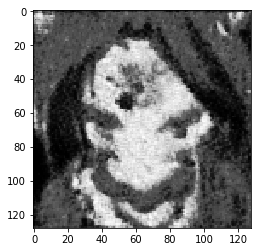

Estimate: [[-27.34937668]]
Iteration: 10400 at 2018-01-09 00:49:27.017457


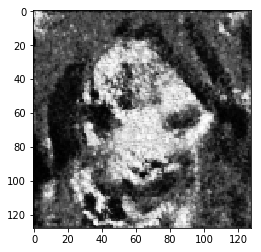

Estimate: [[-12.27767563]]
Iteration: 10500 at 2018-01-09 00:51:22.331153


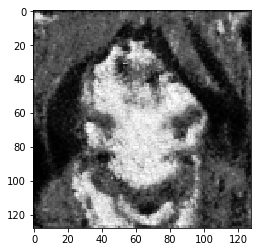

Estimate: [[-26.48273468]]
Iteration: 10600 at 2018-01-09 00:53:16.476813


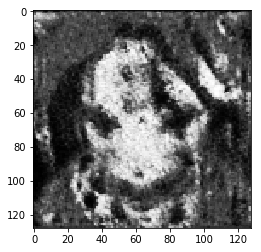

Estimate: [[-30.2074852]]
Iteration: 10700 at 2018-01-09 00:55:11.098778


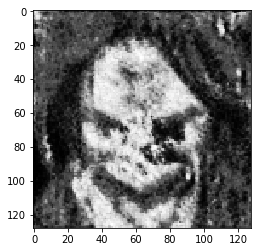

Estimate: [[ 0.06004337]]
Iteration: 10800 at 2018-01-09 00:57:05.695231


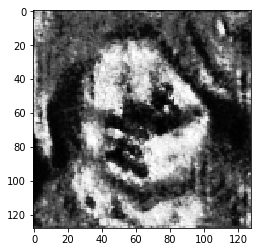

Estimate: [[-5.40690565]]
Iteration: 10900 at 2018-01-09 00:59:00.702715


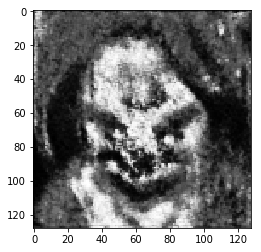

Estimate: [[-10.79230022]]
Iteration: 11000 at 2018-01-09 01:00:55.136526


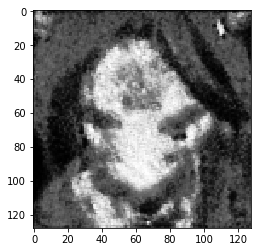

Estimate: [[ 12.67270756]]
Iteration: 11100 at 2018-01-09 01:02:49.853764


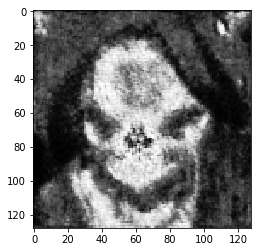

Estimate: [[ 9.96501827]]
Iteration: 11200 at 2018-01-09 01:04:44.572427


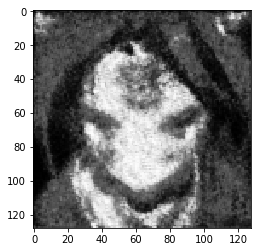

Estimate: [[ 2.25117016]]
Iteration: 11300 at 2018-01-09 01:06:39.798061


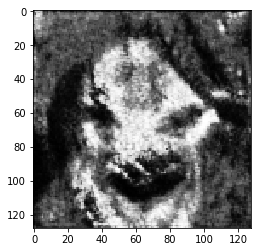

Estimate: [[-13.41754723]]
Iteration: 11400 at 2018-01-09 01:08:35.231722


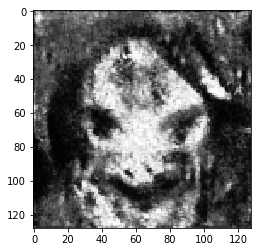

Estimate: [[-19.90361404]]
Iteration: 11500 at 2018-01-09 01:10:29.070346


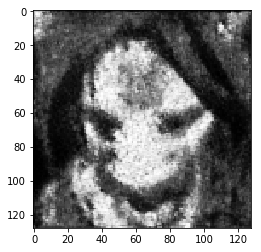

Estimate: [[-3.55462766]]
Iteration: 11600 at 2018-01-09 01:12:23.297457


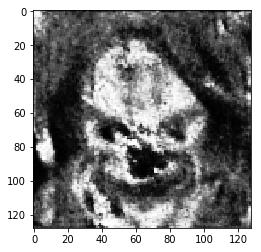

Estimate: [[-28.78949165]]
Iteration: 11700 at 2018-01-09 01:14:18.748116


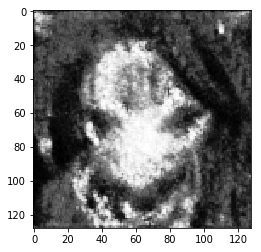

Estimate: [[-0.88026351]]
Iteration: 11800 at 2018-01-09 01:16:13.789768


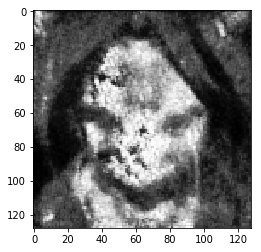

Estimate: [[-10.06080723]]
Iteration: 11900 at 2018-01-09 01:18:08.041966


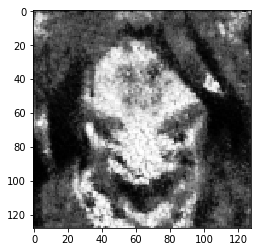

Estimate: [[-11.59221172]]
Iteration: 12000 at 2018-01-09 01:20:03.126523


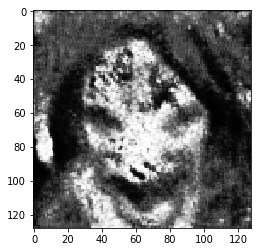

Estimate: [[-11.09631062]]
Iteration: 12100 at 2018-01-09 01:21:57.708158


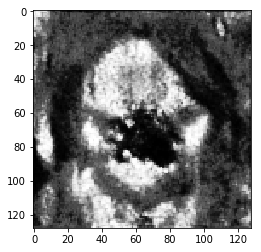

Estimate: [[ 0.96764684]]
Iteration: 12200 at 2018-01-09 01:23:52.165100


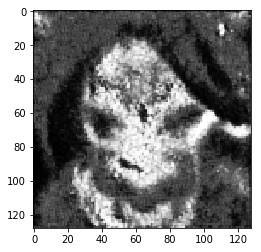

Estimate: [[-8.22888184]]
Iteration: 12300 at 2018-01-09 01:25:47.896446


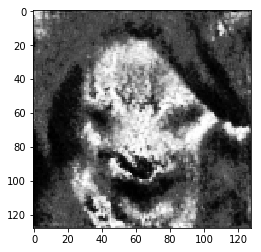

Estimate: [[-11.8768568]]
Iteration: 12400 at 2018-01-09 01:27:41.863303


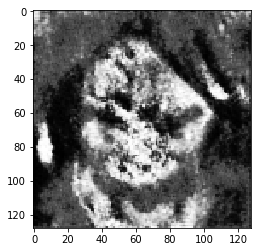

Estimate: [[-13.00456715]]
Iteration: 12500 at 2018-01-09 01:29:36.046173


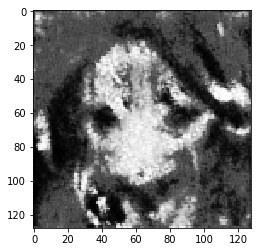

Estimate: [[-11.1426096]]
Iteration: 12600 at 2018-01-09 01:31:29.541912


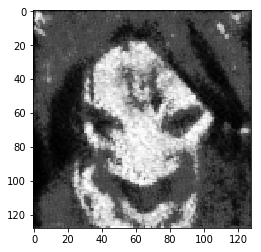

Estimate: [[ 1.00682521]]
Iteration: 12700 at 2018-01-09 01:33:25.001995


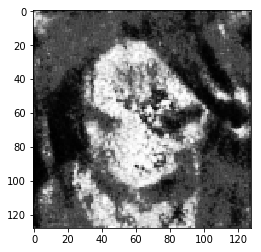

Estimate: [[-2.84783649]]
Iteration: 12800 at 2018-01-09 01:35:19.540568


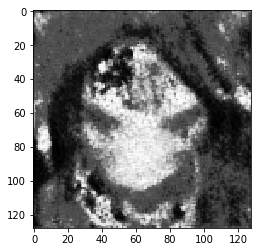

Estimate: [[-6.73197365]]
Iteration: 12900 at 2018-01-09 01:37:14.246881


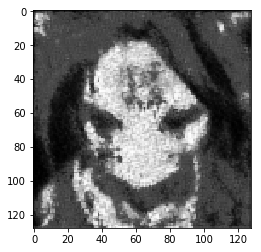

Estimate: [[-10.71394825]]
Iteration: 13000 at 2018-01-09 01:39:08.548576


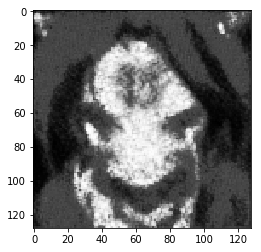

Estimate: [[ 4.26542282]]
Iteration: 13100 at 2018-01-09 01:41:03.017673


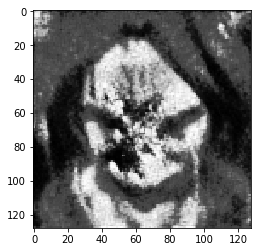

Estimate: [[-4.07862902]]
Iteration: 13200 at 2018-01-09 01:42:58.262624


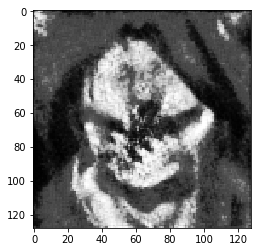

Estimate: [[-4.76785564]]
Iteration: 13300 at 2018-01-09 01:44:53.207641


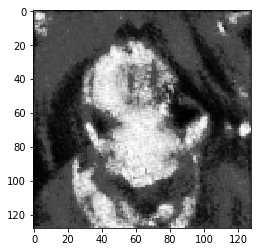

Estimate: [[-6.303864]]
Iteration: 13400 at 2018-01-09 01:46:47.976025


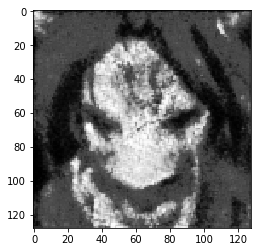

Estimate: [[-0.60233963]]
Iteration: 13500 at 2018-01-09 01:48:42.384333


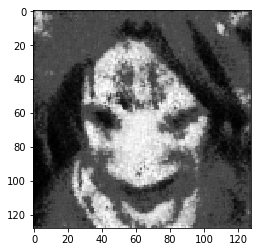

Estimate: [[-3.26271439]]
Iteration: 13600 at 2018-01-09 01:50:36.659886


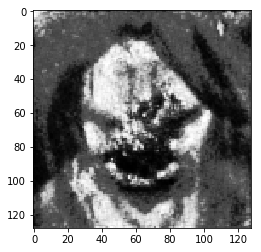

Estimate: [[-1.97984827]]
Iteration: 13700 at 2018-01-09 01:52:31.338553


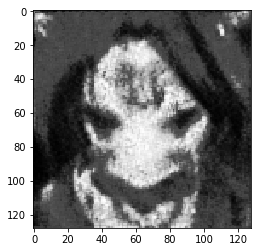

Estimate: [[-1.28849065]]
Iteration: 13800 at 2018-01-09 01:54:25.656902


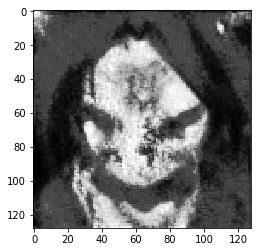

Estimate: [[ 0.75297856]]
Iteration: 13900 at 2018-01-09 01:56:20.678389


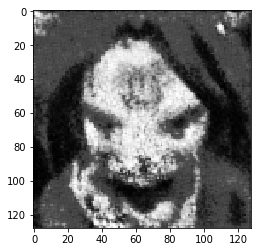

Estimate: [[ 2.2316041]]
Iteration: 14000 at 2018-01-09 01:58:15.394396


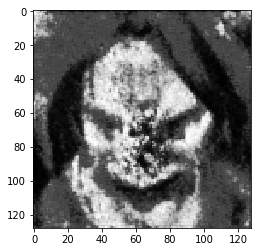

Estimate: [[-9.18912697]]
Iteration: 14100 at 2018-01-09 02:00:09.770540


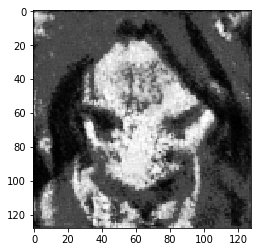

Estimate: [[-5.07085085]]
Iteration: 14200 at 2018-01-09 02:02:05.451869


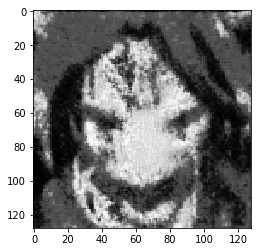

Estimate: [[ 0.11682206]]
Iteration: 14300 at 2018-01-09 02:04:00.098886


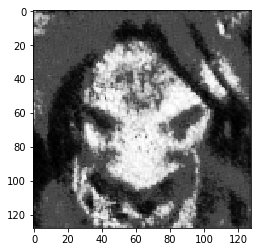

Estimate: [[-0.14002153]]
Iteration: 14400 at 2018-01-09 02:05:55.115630


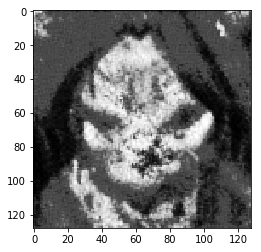

Estimate: [[-2.19766879]]
Iteration: 14500 at 2018-01-09 02:07:49.715748


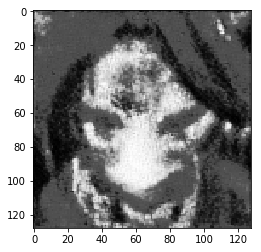

Estimate: [[-0.54876059]]
Iteration: 14600 at 2018-01-09 02:09:44.761289


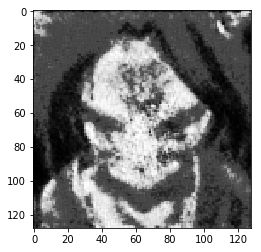

Estimate: [[-2.00519705]]
Iteration: 14700 at 2018-01-09 02:11:40.384850


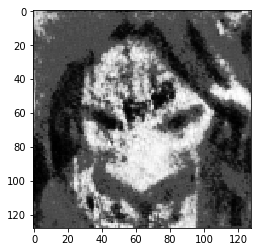

Estimate: [[ 1.12762976]]
Iteration: 14800 at 2018-01-09 02:13:34.831961


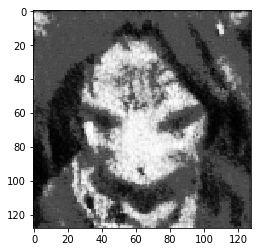

Estimate: [[-2.59739089]]
Iteration: 14900 at 2018-01-09 02:15:29.233869


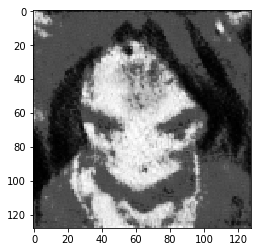

Estimate: [[-1.32096887]]
Iteration: 15000 at 2018-01-09 02:17:23.262072


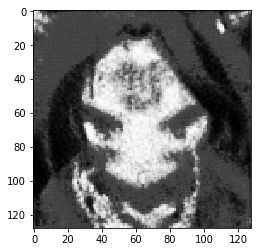

Estimate: [[-0.35854301]]
Iteration: 15100 at 2018-01-09 02:19:18.951119


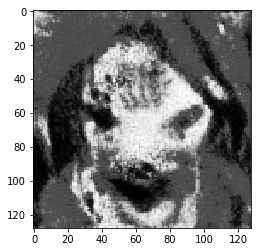

Estimate: [[-2.45551181]]
Iteration: 15200 at 2018-01-09 02:21:14.350308


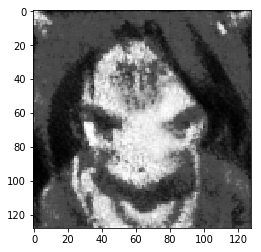

Estimate: [[ 0.89131671]]
Iteration: 15300 at 2018-01-09 02:23:07.928550


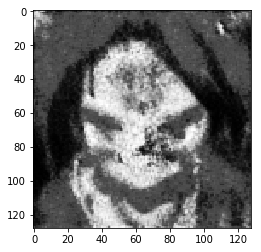

Estimate: [[-0.05589133]]
Iteration: 15400 at 2018-01-09 02:25:03.360853


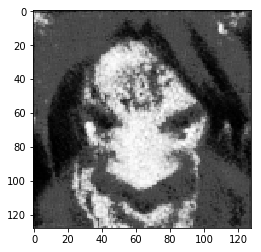

Estimate: [[ 0.44067782]]
Iteration: 15500 at 2018-01-09 02:26:57.427896


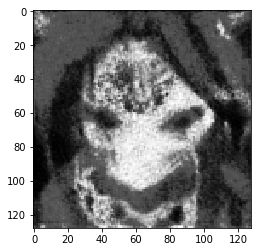

Estimate: [[-3.54741716]]
Iteration: 15600 at 2018-01-09 02:28:52.377799


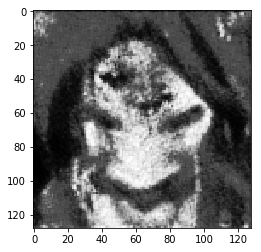

Estimate: [[-3.60893321]]
Iteration: 15700 at 2018-01-09 02:30:46.449778


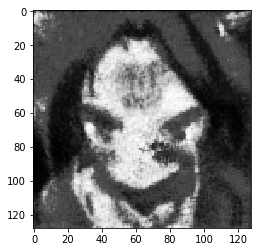

Estimate: [[-0.70227021]]
Iteration: 15800 at 2018-01-09 02:32:41.013000


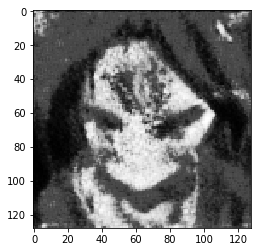

Estimate: [[-6.18537807]]
Iteration: 15900 at 2018-01-09 02:34:35.919185


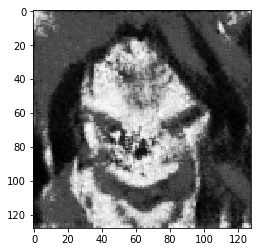

Estimate: [[ 0.1302584]]
Iteration: 16000 at 2018-01-09 02:36:30.445248


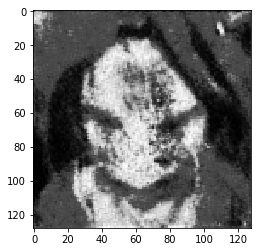

Estimate: [[-2.96590376]]
Iteration: 16100 at 2018-01-09 02:38:26.276221


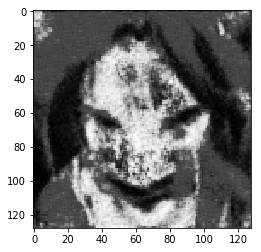

Estimate: [[-3.46335888]]
Iteration: 16200 at 2018-01-09 02:40:21.130123


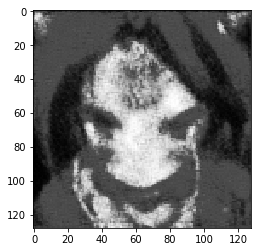

Estimate: [[-6.69886827]]
Iteration: 16300 at 2018-01-09 02:42:16.060690


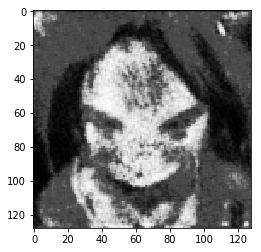

Estimate: [[-2.99673057]]
Iteration: 16400 at 2018-01-09 02:44:11.318508


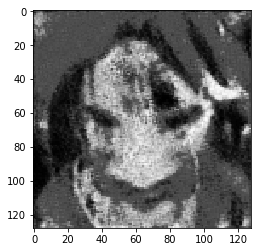

Estimate: [[-5.41174889]]
Iteration: 16500 at 2018-01-09 02:46:04.628811


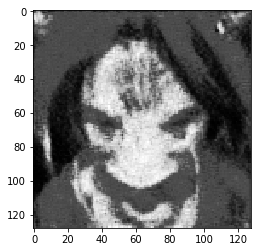

Estimate: [[-7.04394293]]
Iteration: 16600 at 2018-01-09 02:47:59.323244


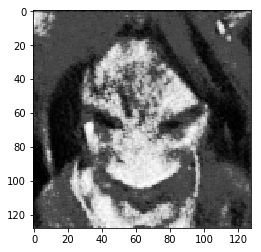

Estimate: [[-10.56540585]]
Iteration: 16700 at 2018-01-09 02:49:53.434523


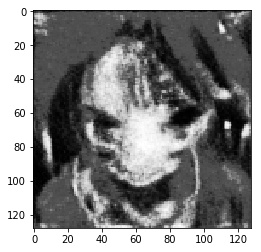

Estimate: [[-6.40541506]]
Iteration: 16800 at 2018-01-09 02:51:48.564126


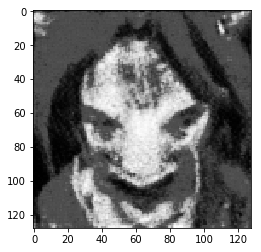

Estimate: [[-9.66142654]]
Iteration: 16900 at 2018-01-09 02:53:43.647061


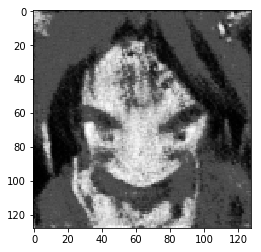

Estimate: [[-4.7667532]]
Iteration: 17000 at 2018-01-09 02:55:38.592667


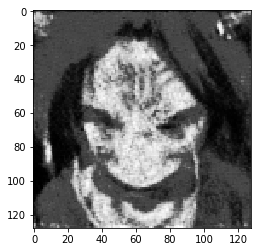

Estimate: [[ 1.89653373]]
Iteration: 17100 at 2018-01-09 02:57:33.875419


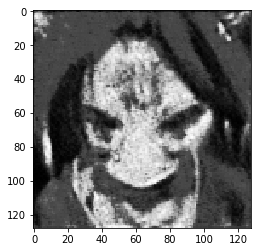

Estimate: [[-11.65090466]]
Iteration: 17200 at 2018-01-09 02:59:27.275994


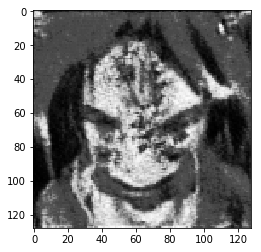

Estimate: [[-11.058918]]
Iteration: 17300 at 2018-01-09 03:01:22.115420


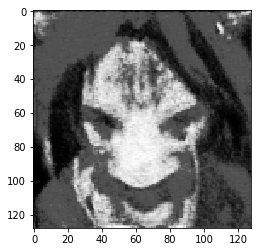

Estimate: [[-4.90273046]]
Iteration: 17400 at 2018-01-09 03:03:17.517087


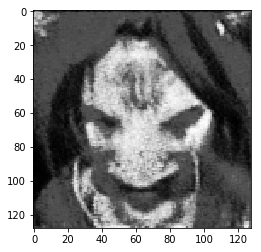

Estimate: [[-7.04292774]]
Iteration: 17500 at 2018-01-09 03:05:13.106986


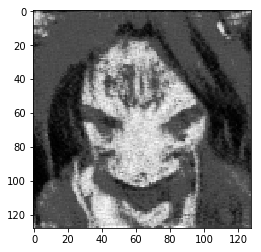

Estimate: [[-5.10832834]]
Iteration: 17600 at 2018-01-09 03:07:07.439741


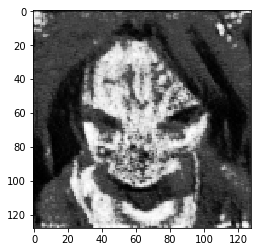

Estimate: [[-8.13020515]]
Iteration: 17700 at 2018-01-09 03:09:01.099522


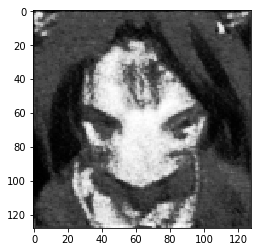

Estimate: [[-1.86894894]]
Iteration: 17800 at 2018-01-09 03:10:56.001031


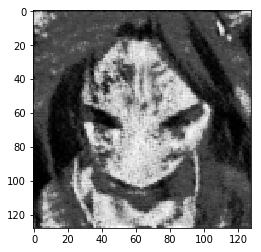

Estimate: [[-3.62098694]]
Iteration: 17900 at 2018-01-09 03:12:50.657344


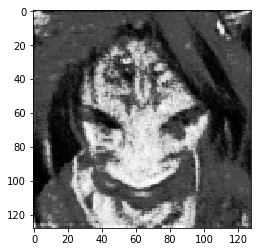

Estimate: [[-8.34178543]]
Iteration: 18000 at 2018-01-09 03:14:45.588172


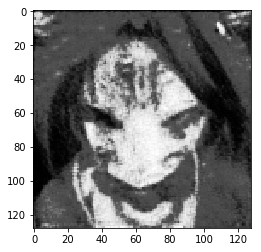

Estimate: [[-7.10525942]]
Iteration: 18100 at 2018-01-09 03:16:40.940323


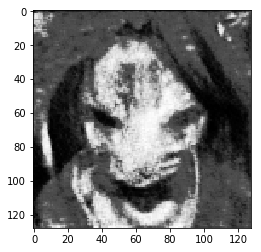

Estimate: [[-12.22047806]]
Iteration: 18200 at 2018-01-09 03:18:35.261131


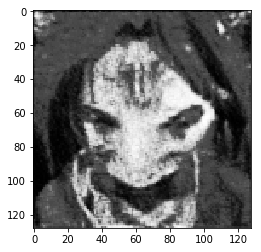

Estimate: [[-2.03950953]]
Iteration: 18300 at 2018-01-09 03:20:29.830906


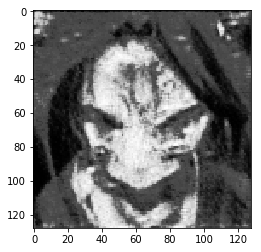

Estimate: [[-17.94823456]]
Iteration: 18400 at 2018-01-09 03:22:23.419311


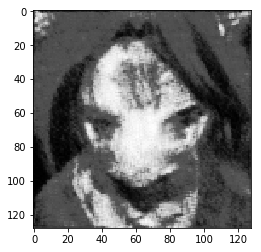

Estimate: [[-5.60942411]]
Iteration: 18500 at 2018-01-09 03:24:18.008916


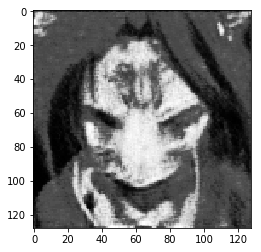

Estimate: [[-7.18983269]]
Iteration: 18600 at 2018-01-09 03:26:13.493860


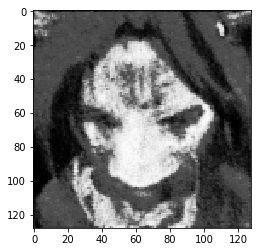

Estimate: [[-10.11358356]]
Iteration: 18700 at 2018-01-09 03:28:07.319008


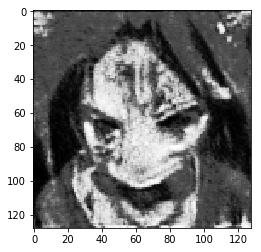

Estimate: [[-12.46206856]]
Iteration: 18800 at 2018-01-09 03:30:02.572243


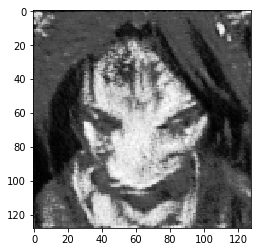

Estimate: [[-4.18719006]]
Iteration: 18900 at 2018-01-09 03:31:55.882743


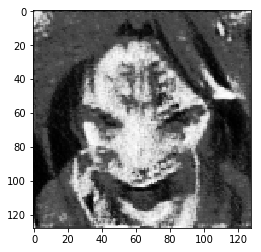

Estimate: [[ 7.60895157]]
Iteration: 19000 at 2018-01-09 03:33:51.234506


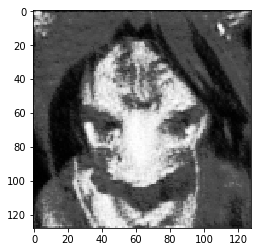

Estimate: [[-1.10416794]]
Iteration: 19100 at 2018-01-09 03:35:44.894770


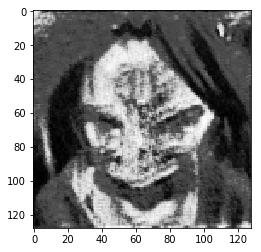

Estimate: [[-2.60971904]]
Iteration: 19200 at 2018-01-09 03:37:40.606630


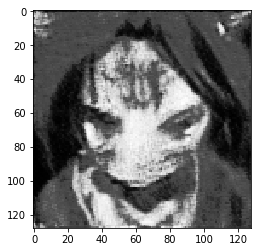

Estimate: [[ 12.3236475]]
Iteration: 19300 at 2018-01-09 03:39:35.196938


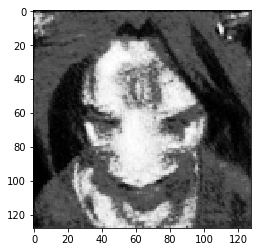

Estimate: [[ 0.39316636]]
Iteration: 19400 at 2018-01-09 03:41:28.968843


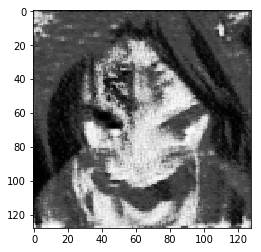

Estimate: [[-8.11536121]]
Iteration: 19500 at 2018-01-09 03:43:23.112049


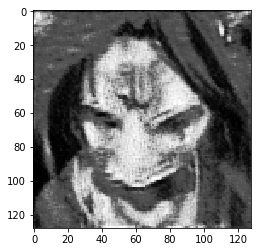

Estimate: [[-9.28683186]]
Iteration: 19600 at 2018-01-09 03:45:16.625905


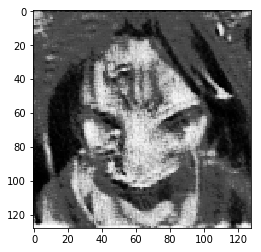

Estimate: [[-9.26841259]]
Iteration: 19700 at 2018-01-09 03:47:11.718057


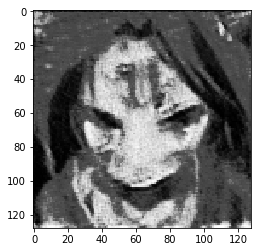

Estimate: [[ 3.59815407]]
Iteration: 19800 at 2018-01-09 03:49:07.488018


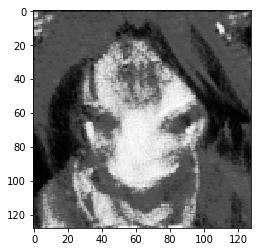

Estimate: [[-3.81839752]]
Iteration: 19900 at 2018-01-09 03:51:01.851272


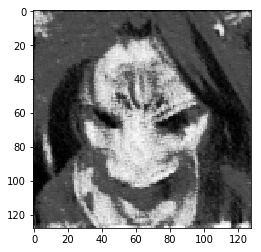

Estimate: [[-0.6737771]]
Iteration: 20000 at 2018-01-09 03:52:57.555271


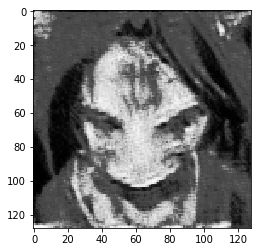

Estimate: [[-9.5348711]]
Iteration: 20100 at 2018-01-09 03:54:51.721920


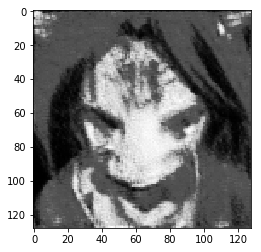

Estimate: [[-1.11450088]]
Iteration: 20200 at 2018-01-09 03:56:46.631860


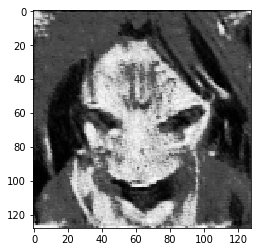

Estimate: [[-2.90254474]]
Iteration: 20300 at 2018-01-09 03:58:42.017958


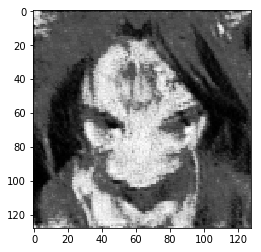

Estimate: [[-14.50686169]]
Iteration: 20400 at 2018-01-09 04:00:36.247847


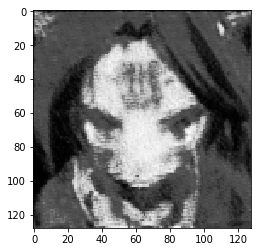

Estimate: [[-5.24298716]]
Iteration: 20500 at 2018-01-09 04:02:32.344063


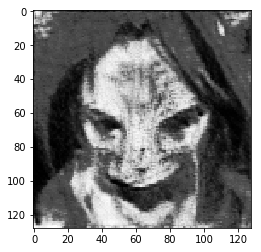

Estimate: [[-7.82471609]]
Iteration: 20600 at 2018-01-09 04:04:27.825355


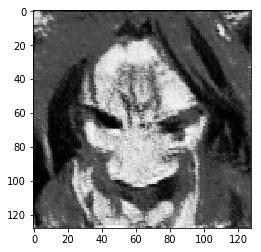

Estimate: [[-3.08055377]]
Iteration: 20700 at 2018-01-09 04:06:23.847805


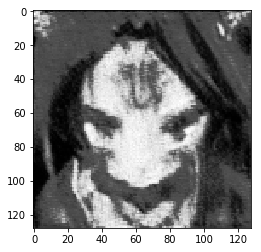

Estimate: [[-4.46754217]]
Iteration: 20800 at 2018-01-09 04:08:19.903643


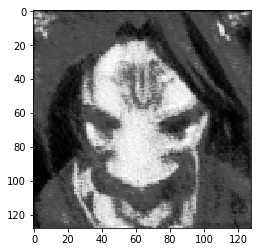

Estimate: [[-2.34685206]]
Iteration: 20900 at 2018-01-09 04:10:16.689451


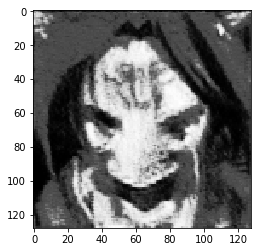

Estimate: [[-4.25549841]]
Iteration: 21000 at 2018-01-09 04:12:13.099640


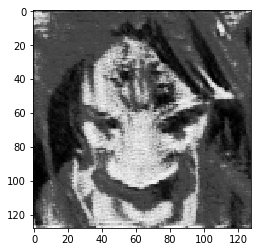

Estimate: [[-10.83229351]]
Iteration: 21100 at 2018-01-09 04:14:09.372707


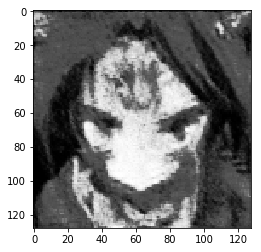

Estimate: [[-5.9211421]]
Iteration: 21200 at 2018-01-09 04:16:05.525060


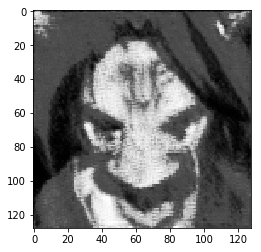

Estimate: [[-0.07500833]]
Iteration: 21300 at 2018-01-09 04:18:00.152168


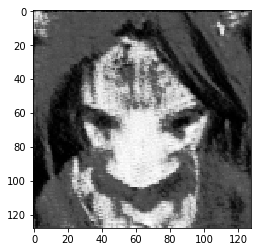

Estimate: [[-2.12492704]]
Iteration: 21400 at 2018-01-09 04:19:55.788773


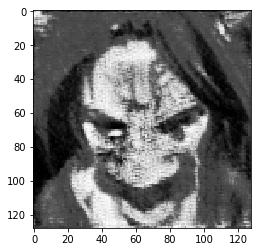

Estimate: [[-4.94268608]]
Iteration: 21500 at 2018-01-09 04:21:52.139488


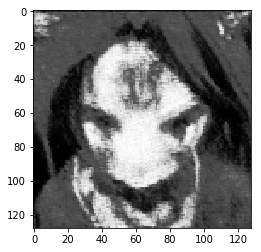

Estimate: [[-1.58180749]]
Iteration: 21600 at 2018-01-09 04:23:47.872827


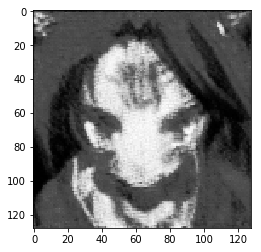

Estimate: [[-0.16095929]]
Iteration: 21700 at 2018-01-09 04:25:43.801021


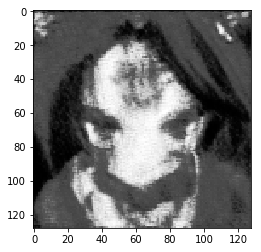

Estimate: [[-0.20416668]]
Iteration: 21800 at 2018-01-09 04:27:39.768875


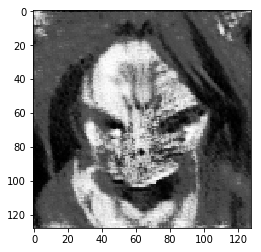

Estimate: [[-6.42506886]]
Iteration: 21900 at 2018-01-09 04:29:36.032874


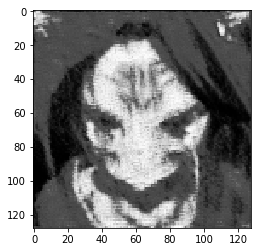

Estimate: [[-2.55277491]]
Iteration: 22000 at 2018-01-09 04:31:31.518625


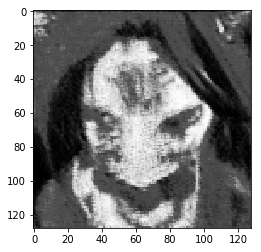

Estimate: [[ 0.92899591]]
Iteration: 22100 at 2018-01-09 04:33:27.005262


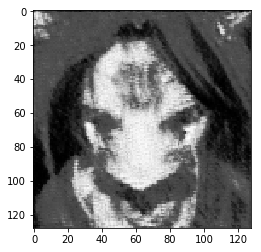

Estimate: [[ 1.10587537]]
Iteration: 22200 at 2018-01-09 04:35:22.210649


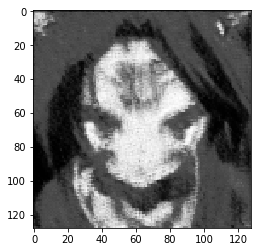

Estimate: [[ 0.52118576]]
Iteration: 22300 at 2018-01-09 04:37:17.612883


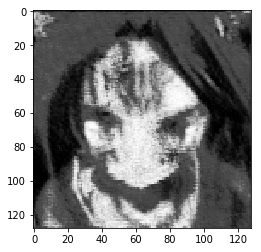

Estimate: [[-0.25901458]]
Iteration: 22400 at 2018-01-09 04:39:14.548377


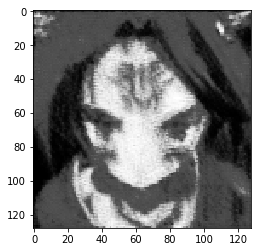

Estimate: [[-3.35512757]]
Iteration: 22500 at 2018-01-09 04:41:09.436203


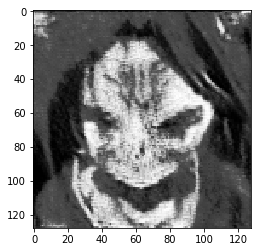

Estimate: [[-5.48597097]]
Iteration: 22600 at 2018-01-09 04:43:06.382939


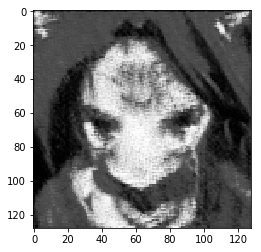

Estimate: [[-2.06723356]]
Iteration: 22700 at 2018-01-09 04:45:02.012417


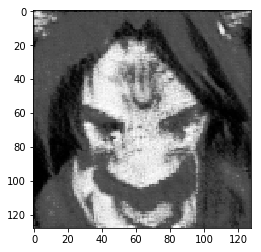

Estimate: [[-1.98721445]]
Iteration: 22800 at 2018-01-09 04:46:57.841511


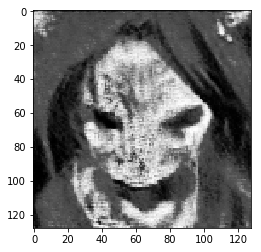

Estimate: [[-9.17478943]]
Iteration: 22900 at 2018-01-09 04:48:53.400950


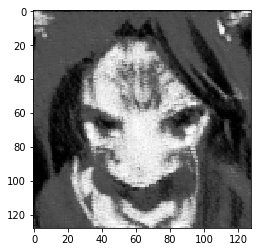

Estimate: [[ 5.65449905]]
Iteration: 23000 at 2018-01-09 04:50:49.326345


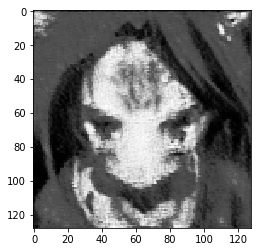

Estimate: [[-2.90976524]]
Iteration: 23100 at 2018-01-09 04:52:46.677327


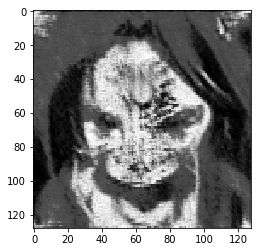

Estimate: [[-6.36027765]]
Iteration: 23200 at 2018-01-09 04:54:43.912105


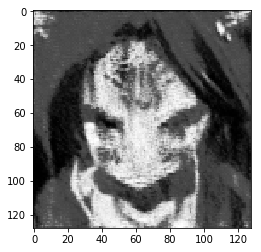

Estimate: [[-0.36293799]]
Iteration: 23300 at 2018-01-09 04:56:39.860498


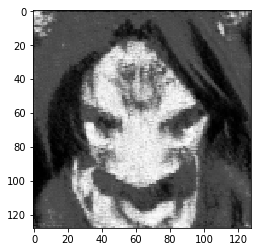

Estimate: [[-1.55691302]]
Iteration: 23400 at 2018-01-09 04:58:36.280272


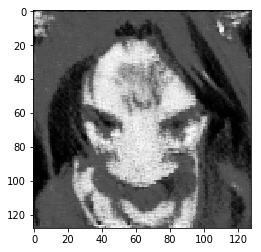

Estimate: [[-1.87886834]]
Iteration: 23500 at 2018-01-09 05:00:32.138671


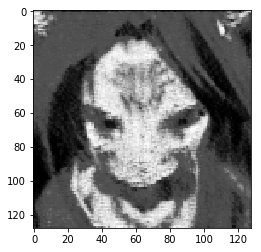

Estimate: [[-6.26061535]]
Iteration: 23600 at 2018-01-09 05:02:28.369896


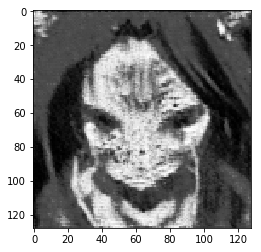

Estimate: [[-6.30292702]]
Iteration: 23700 at 2018-01-09 05:04:23.509118


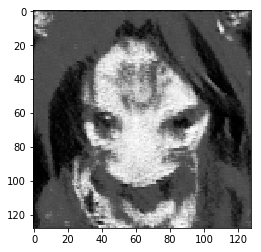

Estimate: [[-5.06073284]]
Iteration: 23800 at 2018-01-09 05:06:20.034893


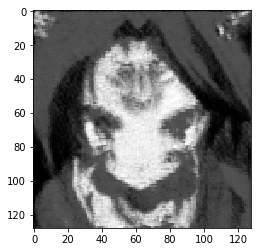

Estimate: [[ 2.90126324]]
Iteration: 23900 at 2018-01-09 05:08:16.458183


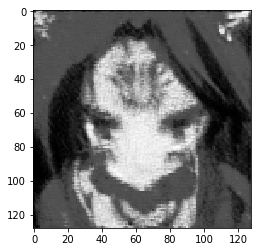

Estimate: [[-5.27515793]]
Iteration: 24000 at 2018-01-09 05:10:11.434194


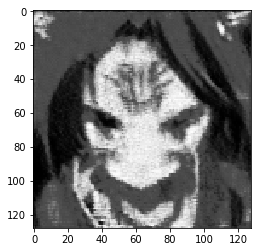

Estimate: [[-10.62274837]]
Iteration: 24100 at 2018-01-09 05:12:07.916640


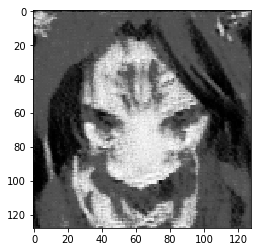

Estimate: [[-2.9626019]]
Iteration: 24200 at 2018-01-09 05:14:04.232174


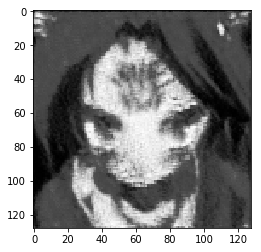

Estimate: [[-8.70315552]]
Iteration: 24300 at 2018-01-09 05:16:01.366148


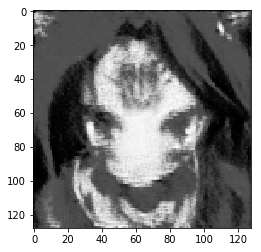

Estimate: [[ 2.62795401]]
Iteration: 24400 at 2018-01-09 05:17:57.258542


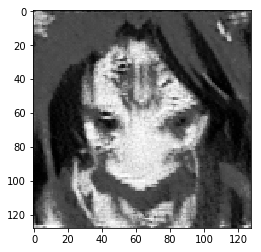

Estimate: [[ 7.09268475]]
Iteration: 24500 at 2018-01-09 05:19:53.157450


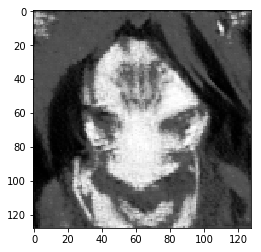

Estimate: [[-5.46619606]]
Iteration: 24600 at 2018-01-09 05:21:49.716231


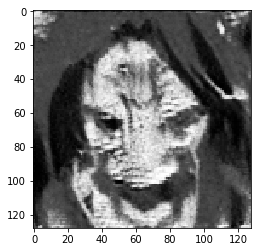

Estimate: [[-2.24963355]]
Iteration: 24700 at 2018-01-09 05:23:44.711197


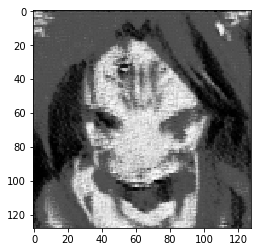

Estimate: [[-1.50970864]]
Iteration: 24800 at 2018-01-09 05:25:40.309300


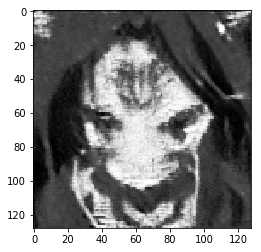

Estimate: [[-6.41799307]]
Iteration: 24900 at 2018-01-09 05:27:35.218098


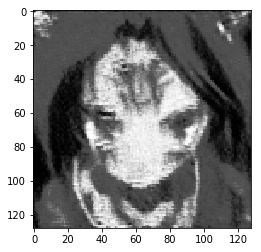

Estimate: [[-7.68007994]]
Iteration: 25000 at 2018-01-09 05:29:31.221164


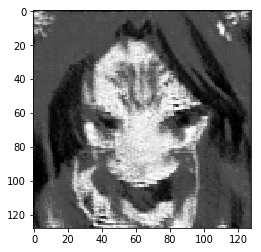

Estimate: [[-9.6431036]]
Iteration: 25100 at 2018-01-09 05:31:27.939256


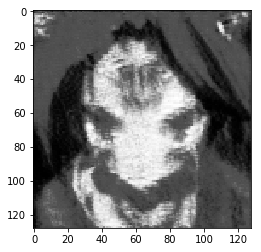

Estimate: [[-5.67040777]]
Iteration: 25200 at 2018-01-09 05:33:23.444915


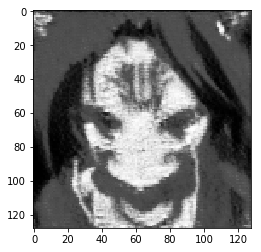

Estimate: [[ 2.28340316]]
Iteration: 25300 at 2018-01-09 05:35:19.939837


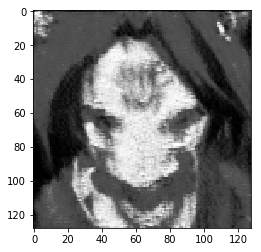

Estimate: [[-1.85083711]]
Iteration: 25400 at 2018-01-09 05:37:14.765165


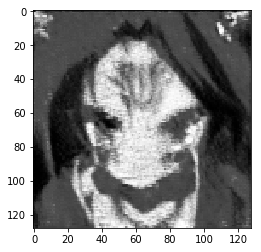

Estimate: [[-1.45506859]]
Iteration: 25500 at 2018-01-09 05:39:11.446531


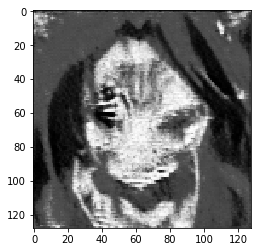

Estimate: [[-15.54148197]]
Iteration: 25600 at 2018-01-09 05:41:07.964235


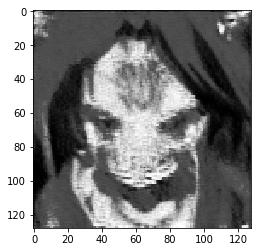

Estimate: [[-0.61058801]]
Iteration: 25700 at 2018-01-09 05:43:03.488172


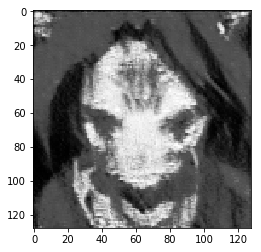

Estimate: [[-6.70213223]]
Iteration: 25800 at 2018-01-09 05:45:00.519671


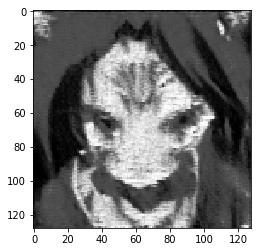

Estimate: [[-5.58344078]]
Iteration: 25900 at 2018-01-09 05:46:55.977369


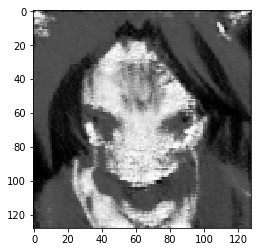

Estimate: [[-14.23836899]]
Iteration: 26000 at 2018-01-09 05:48:53.178451


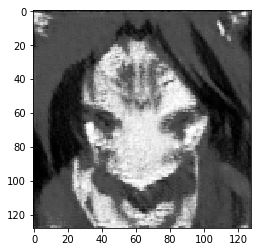

Estimate: [[-1.29746699]]
Iteration: 26100 at 2018-01-09 05:50:48.070048


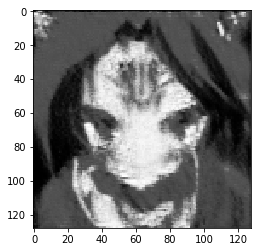

Estimate: [[-23.9624176]]
Iteration: 26200 at 2018-01-09 05:52:44.298101


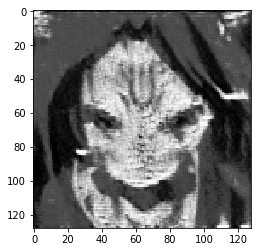

Estimate: [[-10.12374973]]
Iteration: 26300 at 2018-01-09 05:54:41.309295


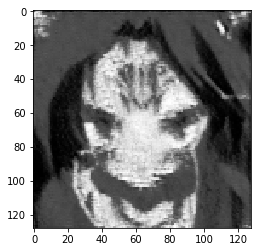

Estimate: [[-20.50945091]]
Iteration: 26400 at 2018-01-09 05:56:37.681569


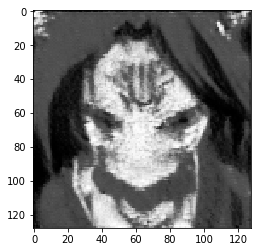

Estimate: [[-11.52703667]]
Iteration: 26500 at 2018-01-09 05:58:34.590407


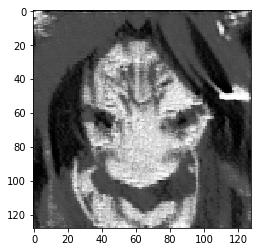

Estimate: [[-3.98450327]]
Iteration: 26600 at 2018-01-09 06:00:30.293414


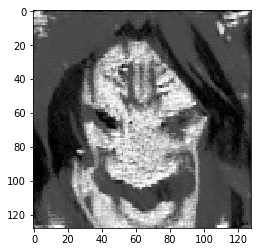

Estimate: [[-14.36998653]]
Iteration: 26700 at 2018-01-09 06:02:28.098192


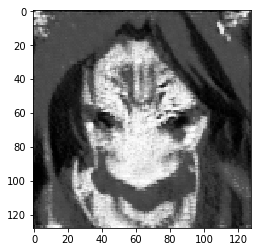

Estimate: [[-3.55468321]]
Iteration: 26800 at 2018-01-09 06:04:24.863481


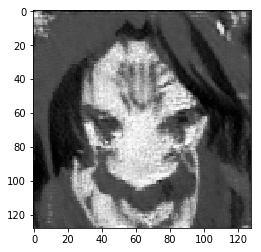

Estimate: [[-11.62160778]]
Iteration: 26900 at 2018-01-09 06:06:20.731800


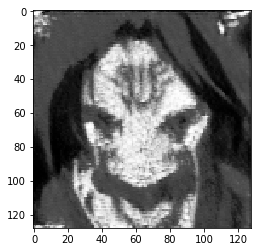

Estimate: [[-2.06837654]]
Iteration: 27000 at 2018-01-09 06:08:17.566213


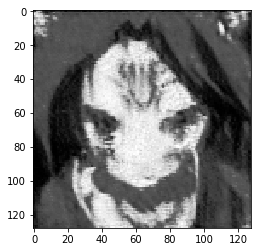

Estimate: [[-2.77986574]]
Iteration: 27100 at 2018-01-09 06:10:13.439275


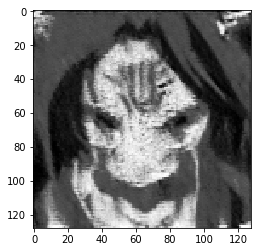

Estimate: [[-18.2930088]]
Iteration: 27200 at 2018-01-09 06:12:11.256699


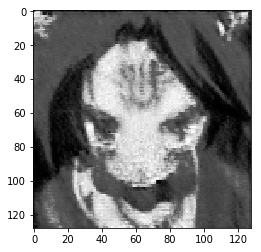

Estimate: [[-4.02241659]]
Iteration: 27300 at 2018-01-09 06:14:06.748018


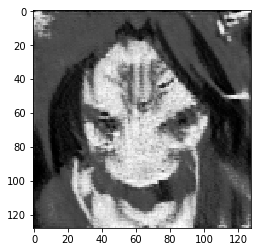

Estimate: [[-7.68845081]]
Iteration: 27400 at 2018-01-09 06:16:03.392326


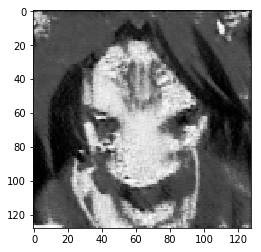

Estimate: [[-4.96662569]]
Iteration: 27500 at 2018-01-09 06:18:00.580053


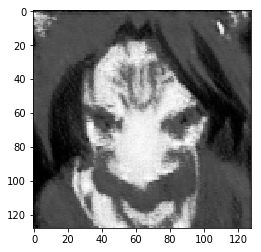

Estimate: [[-7.22631979]]
Iteration: 27600 at 2018-01-09 06:19:56.257539


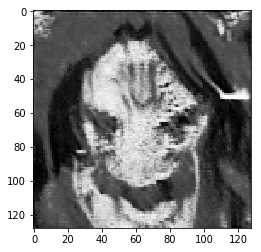

Estimate: [[-12.9319334]]
Iteration: 27700 at 2018-01-09 06:21:53.375322


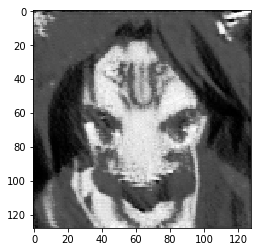

Estimate: [[-6.69445038]]
Iteration: 27800 at 2018-01-09 06:23:49.852896


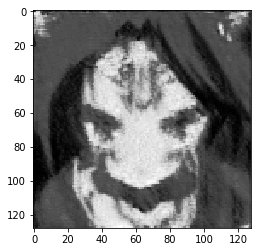

Estimate: [[-24.76433182]]
Iteration: 27900 at 2018-01-09 06:25:46.984767


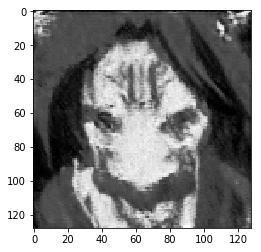

Estimate: [[-6.76429701]]
Iteration: 28000 at 2018-01-09 06:27:43.892547


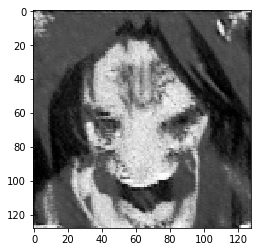

Estimate: [[-3.4873569]]
Iteration: 28100 at 2018-01-09 06:29:39.443502


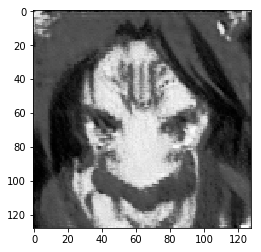

Estimate: [[-3.51977611]]
Iteration: 28200 at 2018-01-09 06:31:35.023987


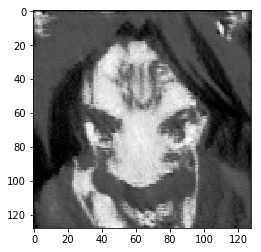

Estimate: [[-0.06519288]]
Iteration: 28300 at 2018-01-09 06:33:31.046978


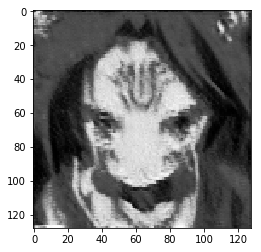

Estimate: [[ 23.12359428]]
Iteration: 28400 at 2018-01-09 06:35:28.013993


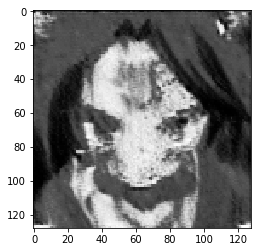

Estimate: [[-0.10777332]]
Iteration: 28500 at 2018-01-09 06:37:24.718501


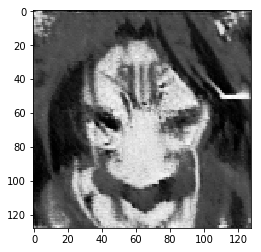

Estimate: [[-8.09614849]]
Iteration: 28600 at 2018-01-09 06:39:21.222944


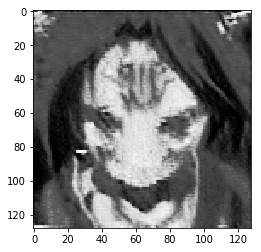

Estimate: [[-10.31791878]]
Iteration: 28700 at 2018-01-09 06:41:17.742716


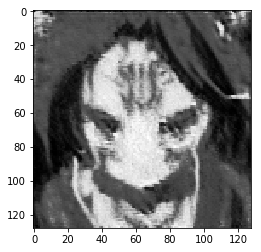

Estimate: [[-13.60991573]]
Iteration: 28800 at 2018-01-09 06:43:13.579224


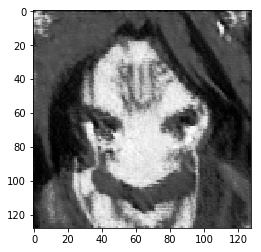

Estimate: [[-6.5505929]]
Iteration: 28900 at 2018-01-09 06:45:10.477541


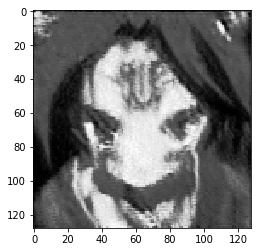

Estimate: [[ 2.39505649]]
Iteration: 29000 at 2018-01-09 06:47:06.112538


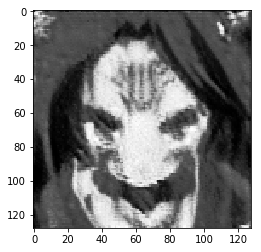

Estimate: [[-12.0195303]]
Iteration: 29100 at 2018-01-09 06:49:02.615585


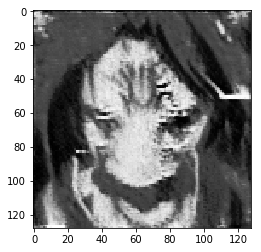

Estimate: [[ 2.34497309]]
Iteration: 29200 at 2018-01-09 06:50:59.434089


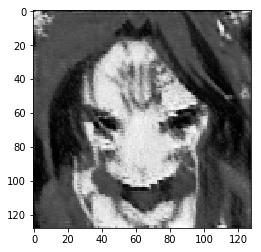

Estimate: [[-15.39704037]]
Iteration: 29300 at 2018-01-09 06:52:55.749734


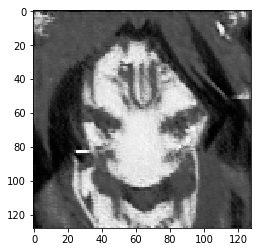

Estimate: [[ 13.46066856]]
Iteration: 29400 at 2018-01-09 06:54:52.701543


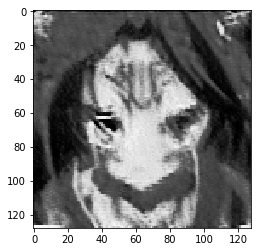

Estimate: [[-2.22502327]]
Iteration: 29500 at 2018-01-09 06:56:47.764664


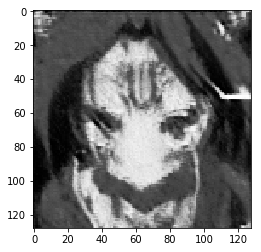

Estimate: [[-15.17319298]]
Iteration: 29600 at 2018-01-09 06:58:44.594925


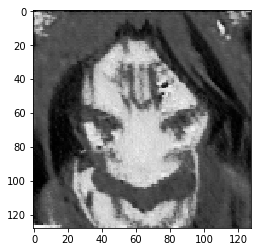

Estimate: [[-1.09648716]]
Iteration: 29700 at 2018-01-09 07:00:40.555968


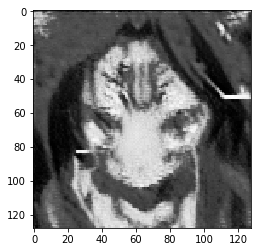

Estimate: [[ 7.83409357]]
Iteration: 29800 at 2018-01-09 07:02:37.303034


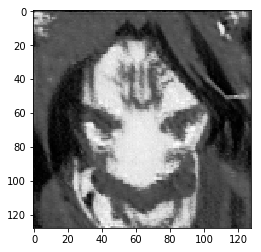

Estimate: [[-0.76829553]]
Iteration: 29900 at 2018-01-09 07:04:34.541068


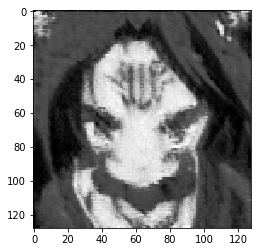

Estimate: [[ 2.92036486]]
Iteration: 30000 at 2018-01-09 07:06:30.805746


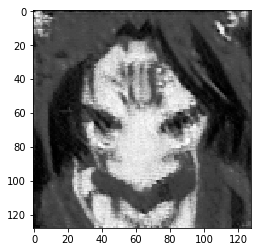

Estimate: [[-8.65936756]]
Iteration: 30100 at 2018-01-09 07:08:26.571526


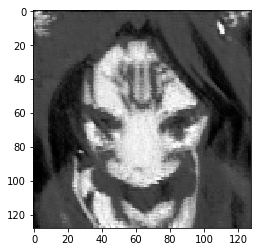

Estimate: [[ 0.5325501]]
Iteration: 30200 at 2018-01-09 07:10:22.552933


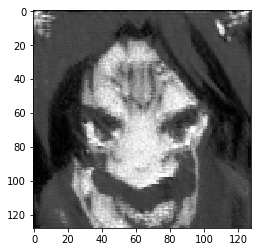

Estimate: [[ 7.73112726]]
Iteration: 30300 at 2018-01-09 07:12:20.233097


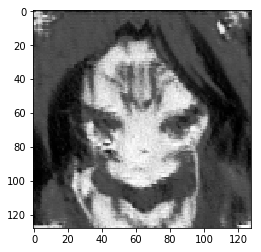

Estimate: [[-12.8466444]]
Iteration: 30400 at 2018-01-09 07:14:17.375123


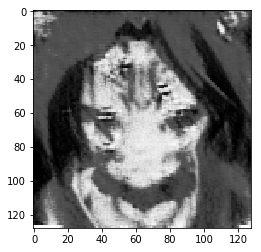

Estimate: [[-16.361269]]
Iteration: 30500 at 2018-01-09 07:16:12.577557


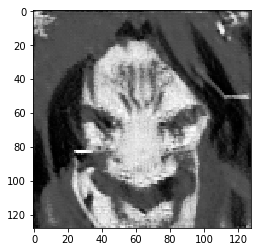

Estimate: [[-16.64542198]]
Iteration: 30600 at 2018-01-09 07:18:10.143083


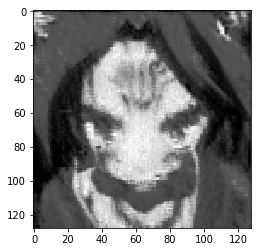

Estimate: [[ 6.13668823]]
Iteration: 30700 at 2018-01-09 07:20:05.845193


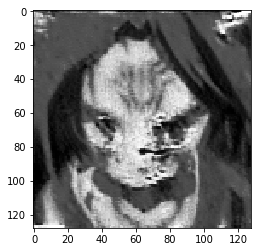

Estimate: [[-7.73469973]]
Iteration: 30800 at 2018-01-09 07:22:02.693219


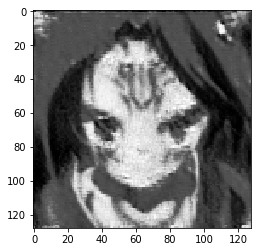

Estimate: [[ 6.66012716]]
Iteration: 30900 at 2018-01-09 07:23:59.240917


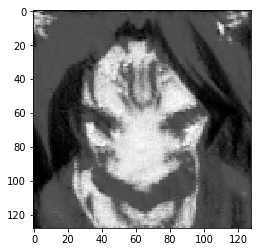

Estimate: [[ 4.279037]]
Iteration: 31000 at 2018-01-09 07:25:56.540942


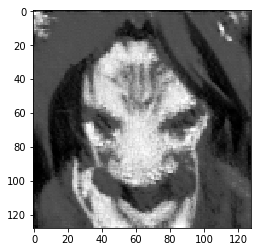

Estimate: [[ 9.17760754]]
Iteration: 31100 at 2018-01-09 07:27:53.259691


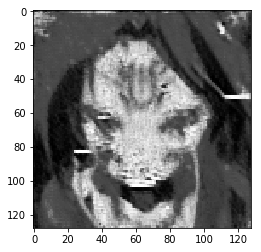

Estimate: [[-25.07788849]]
Iteration: 31200 at 2018-01-09 07:29:49.878277


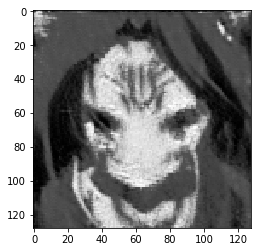

Estimate: [[-8.53618336]]
Iteration: 31300 at 2018-01-09 07:31:46.423082


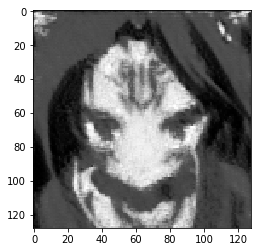

Estimate: [[ 5.50453329]]
Iteration: 31400 at 2018-01-09 07:33:43.437531


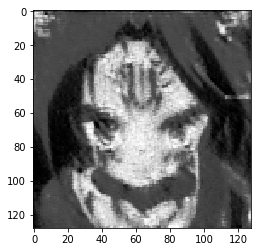

Estimate: [[-7.68423033]]
Iteration: 31500 at 2018-01-09 07:35:40.011712


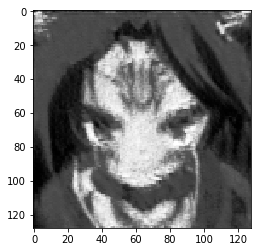

Estimate: [[-17.86141396]]
Iteration: 31600 at 2018-01-09 07:37:36.926926


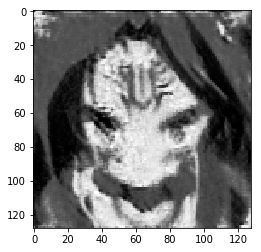

Estimate: [[-24.65253258]]
Iteration: 31700 at 2018-01-09 07:39:34.148678


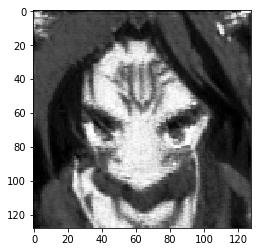

Estimate: [[-10.57821178]]
Iteration: 31800 at 2018-01-09 07:41:30.214769


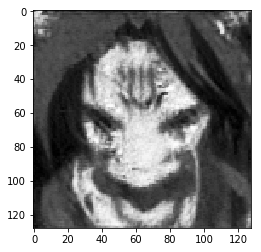

Estimate: [[ 6.77873516]]
Iteration: 31900 at 2018-01-09 07:43:26.687557


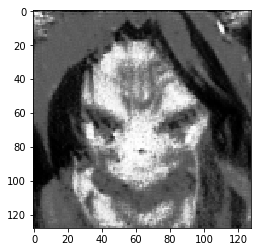

Estimate: [[ 9.04742718]]
Iteration: 32000 at 2018-01-09 07:45:23.850019


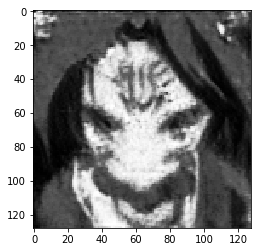

Estimate: [[ 8.56829834]]
Iteration: 32100 at 2018-01-09 07:47:19.578492


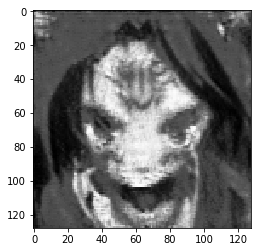

Estimate: [[-1.09412074]]
Iteration: 32200 at 2018-01-09 07:49:16.915107


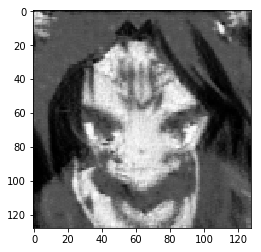

Estimate: [[-11.1767416]]
Iteration: 32300 at 2018-01-09 07:51:14.551164


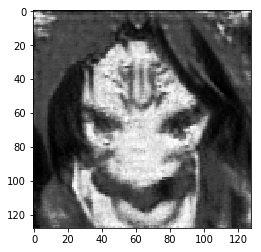

Estimate: [[ 8.34181595]]
Iteration: 32400 at 2018-01-09 07:53:11.091278


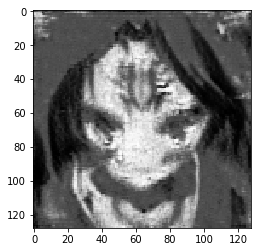

Estimate: [[-5.61522245]]
Iteration: 32500 at 2018-01-09 07:55:07.931708


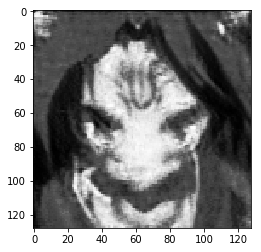

Estimate: [[ 1.71146679]]
Iteration: 32600 at 2018-01-09 07:57:04.322545


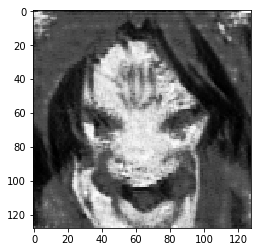

Estimate: [[-2.11784601]]
Iteration: 32700 at 2018-01-09 07:59:01.817065


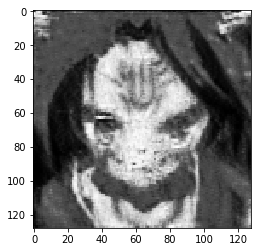

Estimate: [[-25.26874733]]
Iteration: 32800 at 2018-01-09 08:00:58.873450


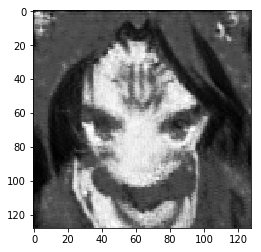

Estimate: [[-6.17198324]]
Iteration: 32900 at 2018-01-09 08:02:56.128934


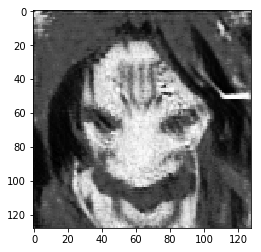

Estimate: [[-4.50492334]]
Iteration: 33000 at 2018-01-09 08:04:53.493153


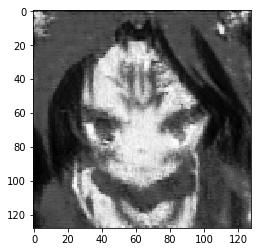

Estimate: [[-7.04476404]]
Iteration: 33100 at 2018-01-09 08:06:49.681744


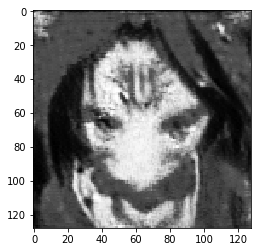

Estimate: [[-9.43933582]]
Iteration: 33200 at 2018-01-09 08:08:47.066875


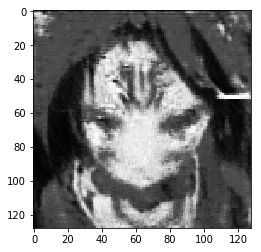

Estimate: [[-8.00530052]]
Iteration: 33300 at 2018-01-09 08:10:42.543426


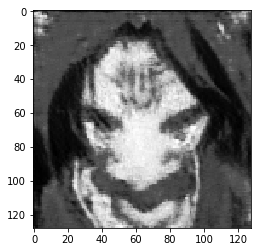

Estimate: [[-11.1109457]]
Iteration: 33400 at 2018-01-09 08:12:39.472509


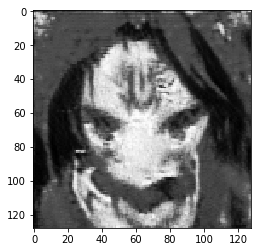

Estimate: [[ 5.32243872]]
Iteration: 33500 at 2018-01-09 08:14:36.564898


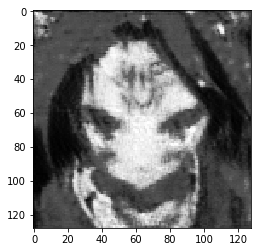

Estimate: [[-9.05092716]]
Iteration: 33600 at 2018-01-09 08:16:34.206533


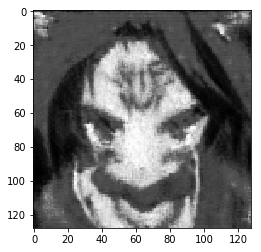

Estimate: [[-2.34680104]]
Iteration: 33700 at 2018-01-09 08:18:31.348797


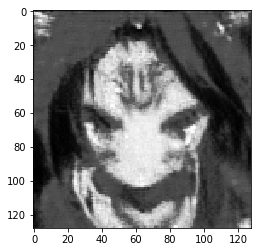

Estimate: [[-3.67516041]]
Iteration: 33800 at 2018-01-09 08:20:28.823927


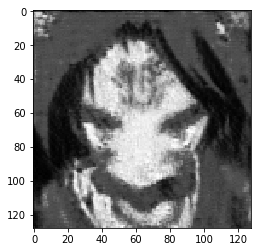

Estimate: [[-8.69147873]]
Iteration: 33900 at 2018-01-09 08:22:25.165678


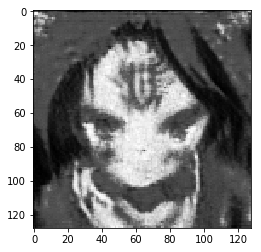

Estimate: [[-0.767097]]
Iteration: 34000 at 2018-01-09 08:24:21.655406


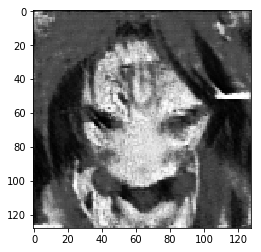

Estimate: [[-9.83770847]]
Iteration: 34100 at 2018-01-09 08:26:19.051816


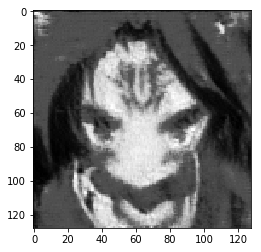

Estimate: [[-11.56087589]]
Iteration: 34200 at 2018-01-09 08:28:16.514799


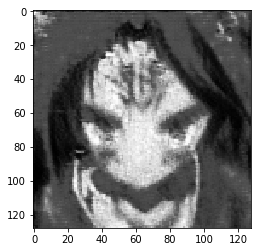

Estimate: [[-6.24293423]]
Iteration: 34300 at 2018-01-09 08:30:12.754456


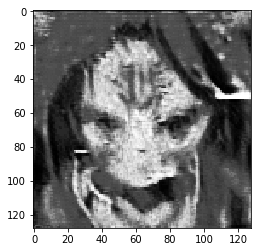

Estimate: [[-4.32405376]]
Iteration: 34400 at 2018-01-09 08:32:09.938229


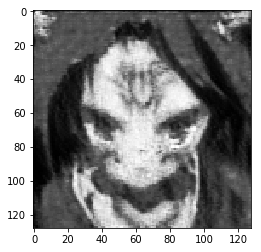

Estimate: [[-5.25345325]]
Iteration: 34500 at 2018-01-09 08:34:06.311176


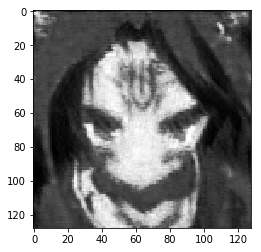

Estimate: [[ 2.14329243]]
Iteration: 34600 at 2018-01-09 08:36:03.901555


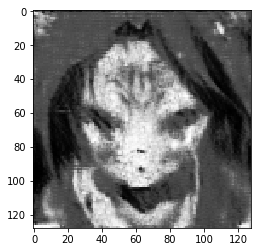

Estimate: [[-6.87246799]]
Iteration: 34700 at 2018-01-09 08:38:00.314743


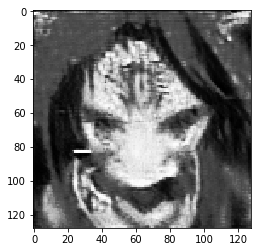

Estimate: [[-10.93602848]]
Iteration: 34800 at 2018-01-09 08:39:58.509628


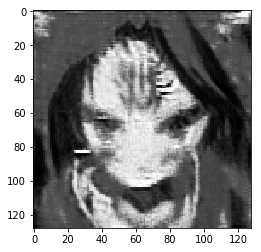

Estimate: [[-18.73259544]]
Iteration: 34900 at 2018-01-09 08:41:57.531912


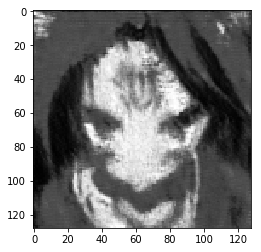

Estimate: [[-4.05631542]]
Iteration: 35000 at 2018-01-09 08:43:53.232454


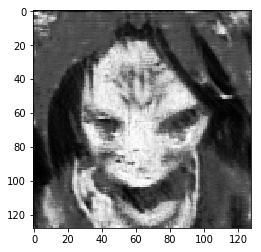

Estimate: [[-1.88599491]]
Iteration: 35100 at 2018-01-09 08:45:51.222977


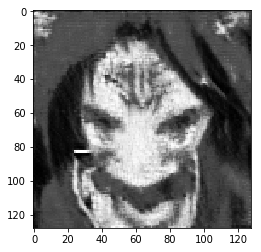

Estimate: [[-3.59477162]]
Iteration: 35200 at 2018-01-09 08:47:48.344577


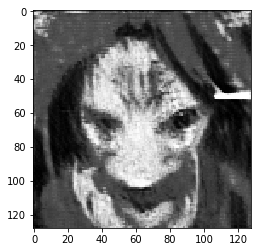

Estimate: [[ 3.21436787]]
Iteration: 35300 at 2018-01-09 08:49:47.016429


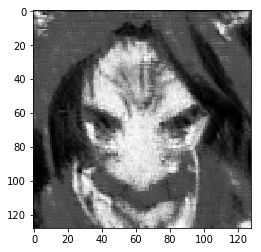

Estimate: [[ 1.10145509]]
Iteration: 35400 at 2018-01-09 08:51:43.399788


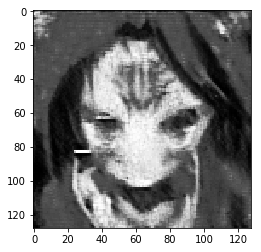

Estimate: [[-15.2428751]]
Iteration: 35500 at 2018-01-09 08:53:41.669527


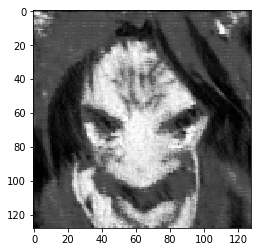

Estimate: [[ 7.10883093]]
Iteration: 35600 at 2018-01-09 08:55:39.344040


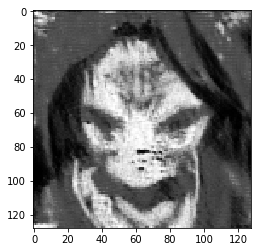

Estimate: [[-9.19790077]]
Iteration: 35700 at 2018-01-09 08:57:36.354529


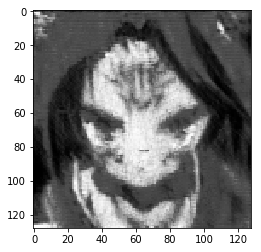

Estimate: [[-0.41290826]]
Iteration: 35800 at 2018-01-09 08:59:33.778425


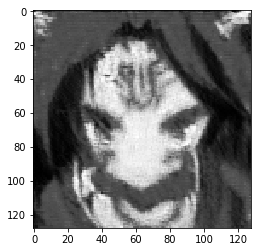

Estimate: [[ 24.26032639]]
Iteration: 35900 at 2018-01-09 09:01:30.832250


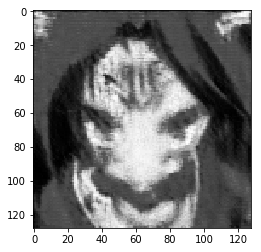

Estimate: [[-2.24940705]]
Iteration: 36000 at 2018-01-09 09:03:28.886421


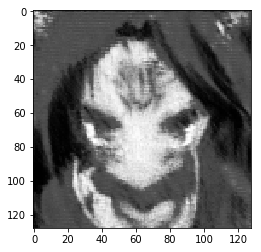

Estimate: [[ 3.04710174]]
Iteration: 36100 at 2018-01-09 09:05:26.247565


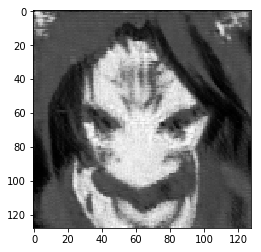

Estimate: [[ 1.02395928]]
Iteration: 36200 at 2018-01-09 09:07:23.304895


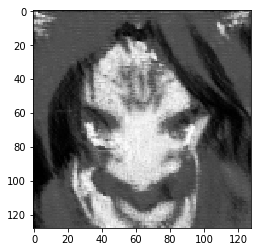

Estimate: [[ 8.06750202]]
Iteration: 36300 at 2018-01-09 09:09:20.264029


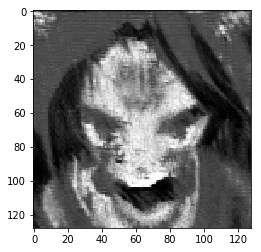

Estimate: [[-3.02449274]]
Iteration: 36400 at 2018-01-09 09:11:17.526233


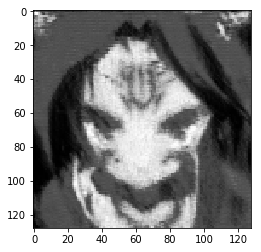

Estimate: [[ 0.3757287]]
Iteration: 36500 at 2018-01-09 09:13:14.599065


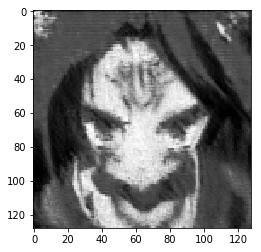

Estimate: [[ 2.95096135]]
Iteration: 36600 at 2018-01-09 09:15:11.835518


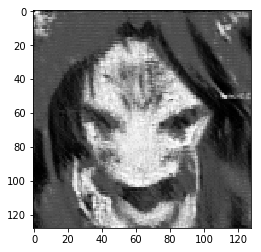

Estimate: [[-14.92189598]]
Iteration: 36700 at 2018-01-09 09:17:10.142675


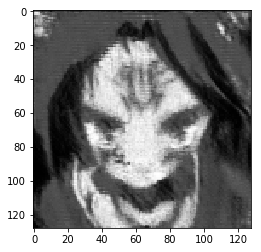

Estimate: [[-10.3503685]]
Iteration: 36800 at 2018-01-09 09:19:07.823898


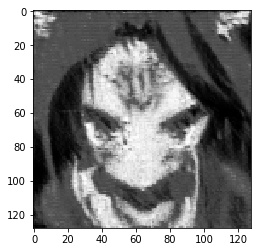

Estimate: [[-13.4602499]]
Iteration: 36900 at 2018-01-09 09:21:04.237777


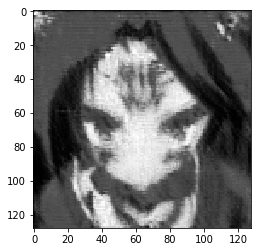

Estimate: [[ 3.8561039]]
Iteration: 37000 at 2018-01-09 09:23:02.254398


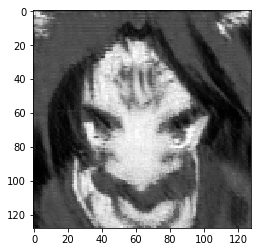

Estimate: [[-9.00133038]]
Iteration: 37100 at 2018-01-09 09:24:57.910331


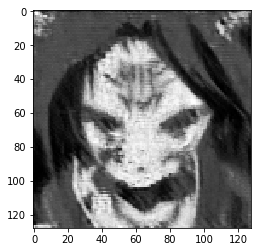

Estimate: [[-13.4741621]]
Iteration: 37200 at 2018-01-09 09:26:56.195875


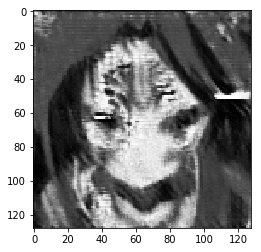

Estimate: [[-14.57622051]]
Iteration: 37300 at 2018-01-09 09:28:51.838193


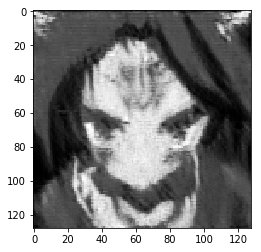

Estimate: [[-3.49064231]]
Iteration: 37400 at 2018-01-09 09:30:49.468376


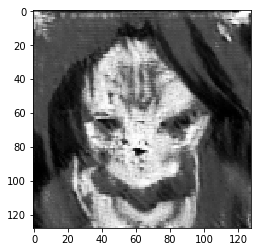

Estimate: [[ 15.33390713]]
Iteration: 37500 at 2018-01-09 09:32:48.486490


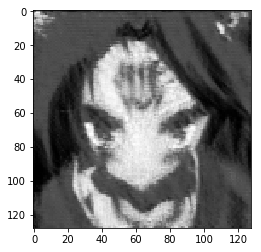

Estimate: [[ 4.68412399]]
Iteration: 37600 at 2018-01-09 09:34:44.413147


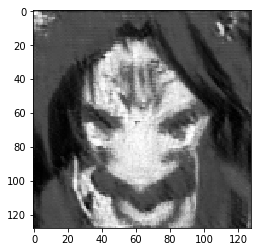

Estimate: [[ 3.61588311]]
Iteration: 37700 at 2018-01-09 09:36:42.506846


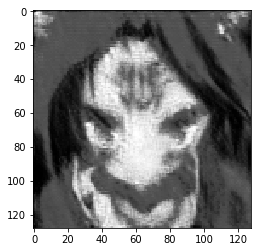

Estimate: [[-2.42021036]]
Iteration: 37800 at 2018-01-09 09:38:38.626332


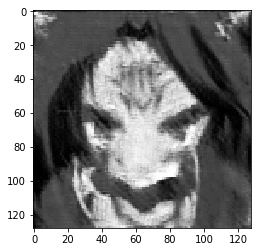

Estimate: [[-9.02999401]]
Iteration: 37900 at 2018-01-09 09:40:36.016708


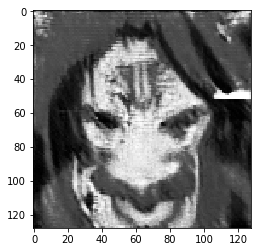

Estimate: [[-3.77766061]]
Iteration: 38000 at 2018-01-09 09:42:34.342129


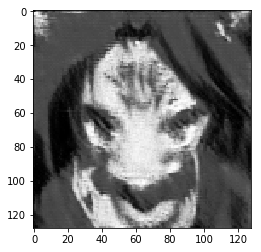

Estimate: [[-7.38601685]]
Iteration: 38100 at 2018-01-09 09:44:31.020217


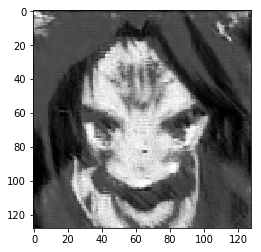

Estimate: [[-2.91106701]]
Iteration: 38200 at 2018-01-09 09:46:29.471326


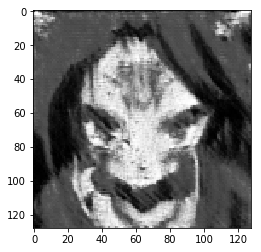

Estimate: [[ 10.49533463]]
Iteration: 38300 at 2018-01-09 09:48:25.722628


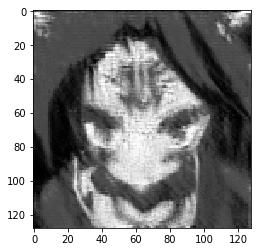

Estimate: [[ 8.95596981]]
Iteration: 38400 at 2018-01-09 09:50:22.817872


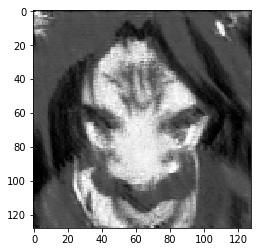

Estimate: [[ 13.09039021]]
Iteration: 38500 at 2018-01-09 09:52:19.871352


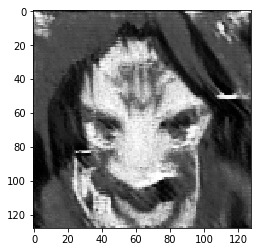

Estimate: [[-2.58969927]]
Iteration: 38600 at 2018-01-09 09:54:17.804044


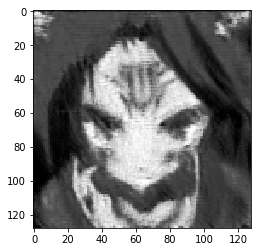

Estimate: [[-24.53796959]]
Iteration: 38700 at 2018-01-09 09:56:15.991979


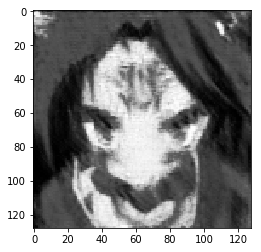

Estimate: [[ 6.94201946]]
Iteration: 38800 at 2018-01-09 09:58:12.429715


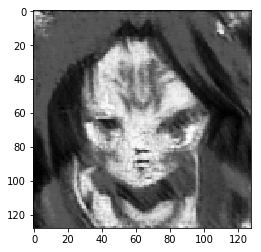

Estimate: [[-14.42716599]]
Iteration: 38900 at 2018-01-09 10:00:09.994756


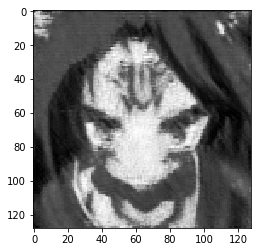

Estimate: [[ 3.00888801]]
Iteration: 39000 at 2018-01-09 10:02:08.164566


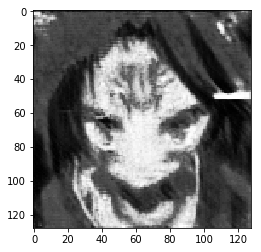

Estimate: [[-1.77650857]]
Iteration: 39100 at 2018-01-09 10:04:05.496593


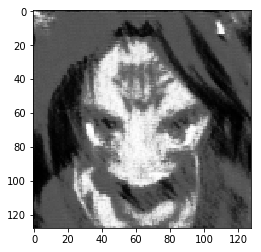

Estimate: [[ 2.30720901]]
Iteration: 39200 at 2018-01-09 10:06:02.310702


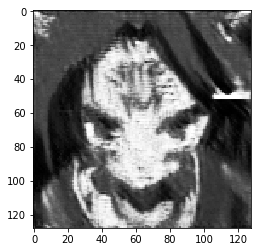

Estimate: [[ 1.18851948]]
Iteration: 39300 at 2018-01-09 10:08:00.951004


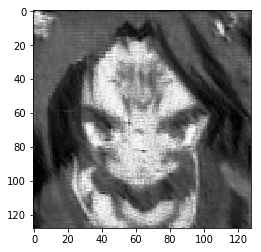

Estimate: [[-7.40542936]]
Iteration: 39400 at 2018-01-09 10:09:59.090511


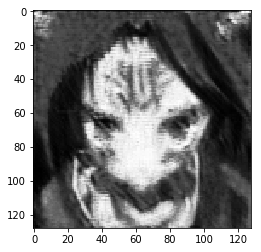

Estimate: [[ 8.92259312]]
Iteration: 39500 at 2018-01-09 10:11:56.238002


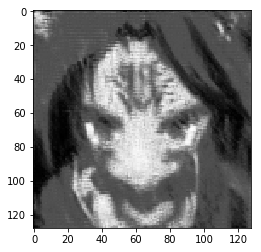

Estimate: [[-2.50394678]]
Iteration: 39600 at 2018-01-09 10:13:54.957660


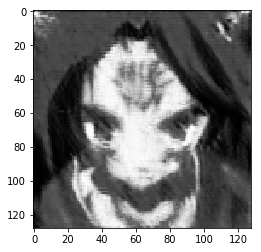

Estimate: [[-0.86777681]]
Iteration: 39700 at 2018-01-09 10:15:51.862207


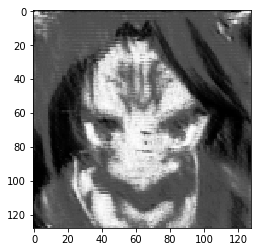

Estimate: [[ 9.25978756]]
Iteration: 39800 at 2018-01-09 10:17:49.879412


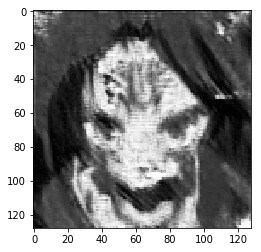

Estimate: [[-11.1281023]]
Iteration: 39900 at 2018-01-09 10:19:48.365935


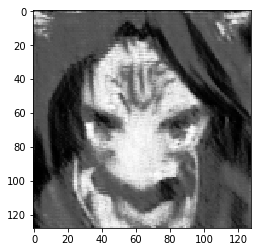

Estimate: [[ 5.66060114]]
Iteration: 40000 at 2018-01-09 10:21:46.059268


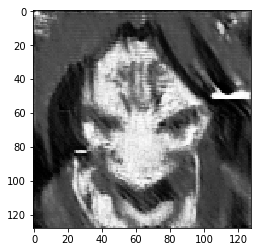

Estimate: [[-9.54194641]]
Iteration: 40100 at 2018-01-09 10:23:45.579274


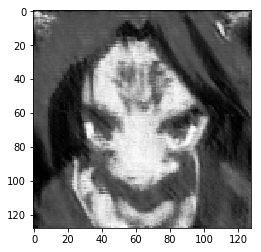

Estimate: [[-15.1070385]]
Iteration: 40200 at 2018-01-09 10:25:41.516871


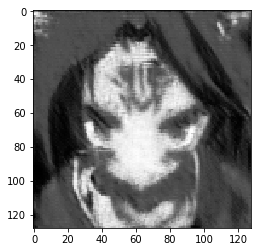

Estimate: [[ 9.7316761]]
Iteration: 40300 at 2018-01-09 10:27:38.458673


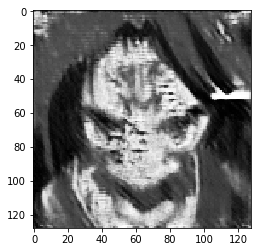

Estimate: [[ 15.73988152]]
Iteration: 40400 at 2018-01-09 10:29:35.597128


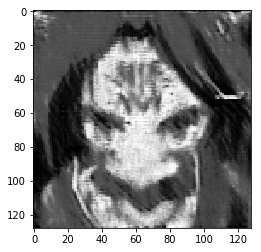

Estimate: [[-0.19499819]]
Iteration: 40500 at 2018-01-09 10:31:33.438734


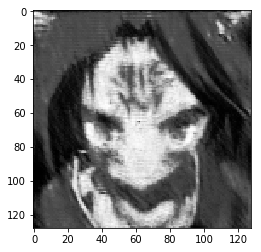

Estimate: [[-9.46836948]]
Iteration: 40600 at 2018-01-09 10:33:30.357900


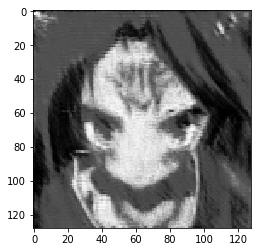

Estimate: [[-2.56970072]]
Iteration: 40700 at 2018-01-09 10:35:27.064189


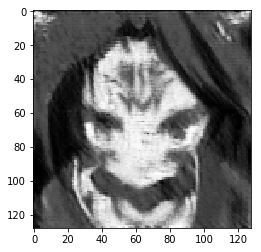

Estimate: [[-8.02776051]]
Iteration: 40800 at 2018-01-09 10:37:25.834339


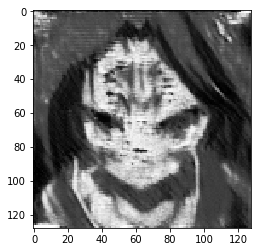

Estimate: [[-8.45142841]]
Iteration: 40900 at 2018-01-09 10:39:23.429550


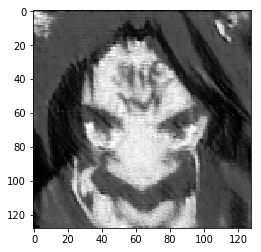

Estimate: [[-3.64380932]]
Iteration: 41000 at 2018-01-09 10:41:20.597596


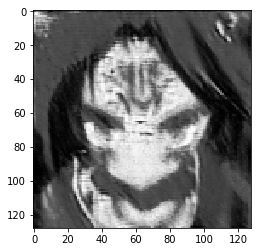

Estimate: [[-2.51744699]]
Iteration: 41100 at 2018-01-09 10:43:17.847142


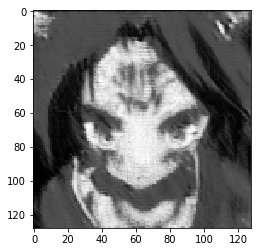

Estimate: [[-13.41381931]]
Iteration: 41200 at 2018-01-09 10:45:14.867651


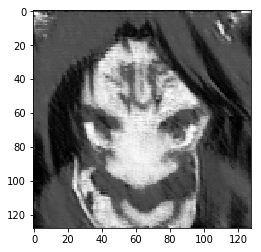

Estimate: [[-8.7021265]]
Iteration: 41300 at 2018-01-09 10:47:12.295732


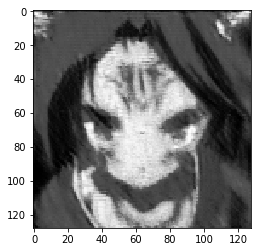

Estimate: [[ 0.09691285]]
Iteration: 41400 at 2018-01-09 10:49:09.776918


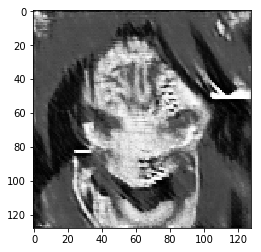

Estimate: [[ 2.47599769]]
Iteration: 41500 at 2018-01-09 10:51:08.384164


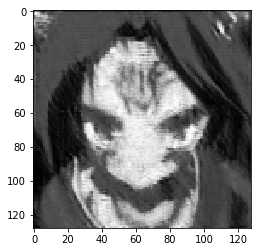

Estimate: [[-10.85415459]]
Iteration: 41600 at 2018-01-09 10:53:04.951048


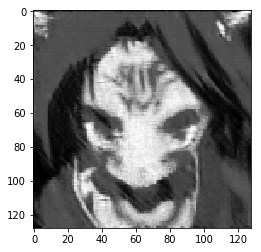

Estimate: [[ 9.50467205]]
Iteration: 41700 at 2018-01-09 10:55:02.372654


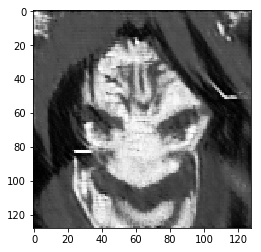

Estimate: [[-2.98023033]]
Iteration: 41800 at 2018-01-09 10:56:59.153243


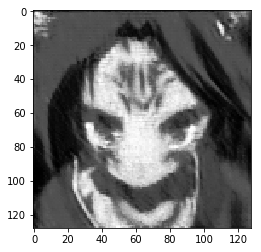

Estimate: [[-7.34170389]]
Iteration: 41900 at 2018-01-09 10:58:57.832970


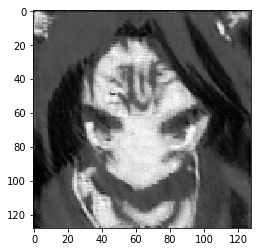

Estimate: [[ 2.52208757]]
Iteration: 42000 at 2018-01-09 11:00:56.044922


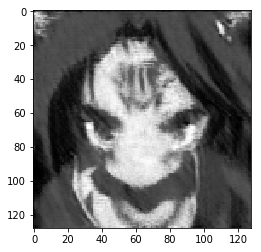

Estimate: [[ 15.35382938]]
Iteration: 42100 at 2018-01-09 11:02:53.056482


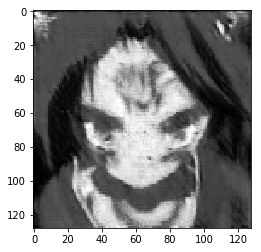

Estimate: [[-4.59258413]]
Iteration: 42200 at 2018-01-09 11:04:50.821589


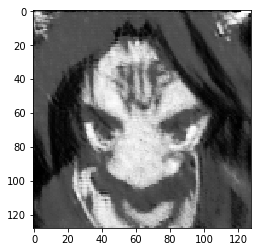

Estimate: [[ 4.17563248]]
Iteration: 42300 at 2018-01-09 11:06:47.377664


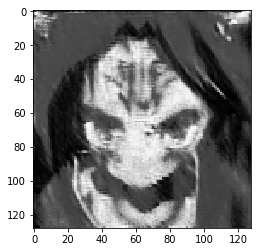

Estimate: [[-16.79795647]]
Iteration: 42400 at 2018-01-09 11:08:45.369333


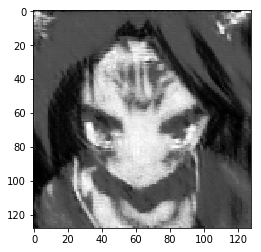

Estimate: [[-6.46783304]]
Iteration: 42500 at 2018-01-09 11:10:41.879850


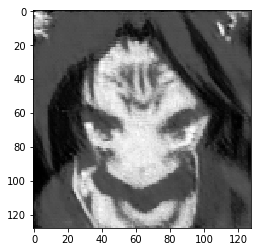

Estimate: [[-3.12736058]]
Iteration: 42600 at 2018-01-09 11:12:40.265993


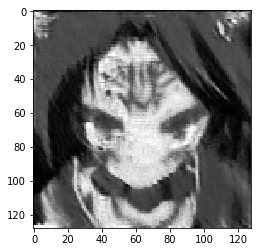

Estimate: [[-10.19766903]]
Iteration: 42700 at 2018-01-09 11:14:39.193621


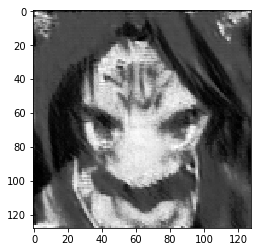

Estimate: [[-4.85551405]]
Iteration: 42800 at 2018-01-09 11:16:37.348073


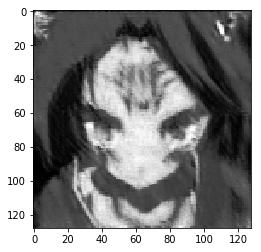

Estimate: [[-11.11906147]]
Iteration: 42900 at 2018-01-09 11:18:35.776528


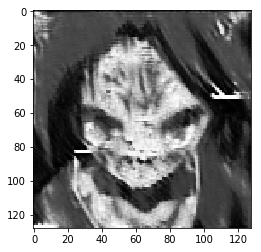

Estimate: [[-7.27680874]]
Iteration: 43000 at 2018-01-09 11:20:33.413291


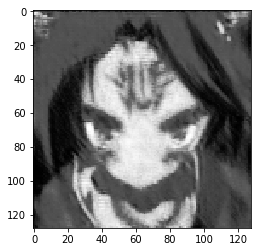

Estimate: [[-0.9997732]]
Iteration: 43100 at 2018-01-09 11:22:31.248694


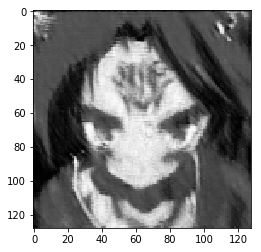

Estimate: [[-14.08089256]]
Iteration: 43200 at 2018-01-09 11:24:30.303453


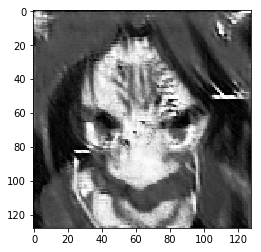

Estimate: [[ 13.54251862]]
Iteration: 43300 at 2018-01-09 11:26:27.876950


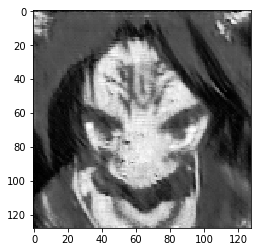

Estimate: [[-2.62108517]]
Iteration: 43400 at 2018-01-09 11:28:26.326770


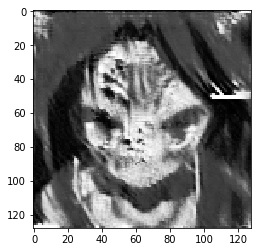

Estimate: [[ 29.85427666]]
Iteration: 43500 at 2018-01-09 11:30:23.580866


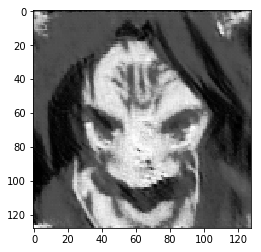

Estimate: [[-2.88202834]]
Iteration: 43600 at 2018-01-09 11:32:21.220181


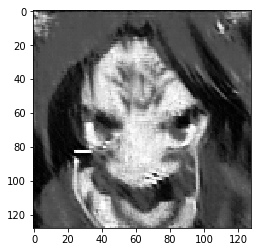

Estimate: [[-20.79728889]]
Iteration: 43700 at 2018-01-09 11:34:17.341761


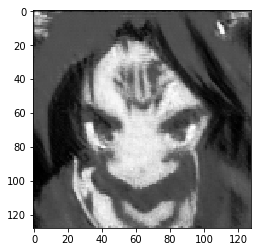

Estimate: [[-1.83429408]]
Iteration: 43800 at 2018-01-09 11:36:15.569657


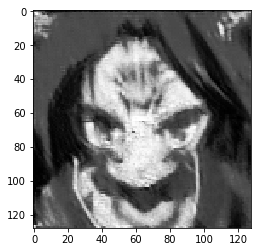

Estimate: [[ 2.93825436]]
Iteration: 43900 at 2018-01-09 11:38:13.428189


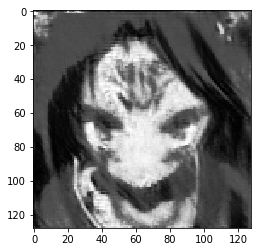

Estimate: [[-8.79017735]]
Iteration: 44000 at 2018-01-09 11:40:10.648944


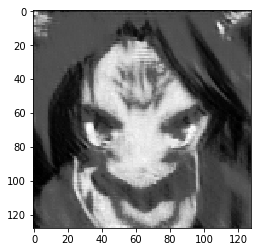

Estimate: [[-2.33028841]]
Iteration: 44100 at 2018-01-09 11:42:08.961480


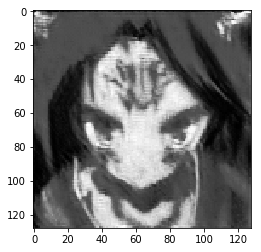

Estimate: [[ 15.30394554]]
Iteration: 44200 at 2018-01-09 11:44:06.603716


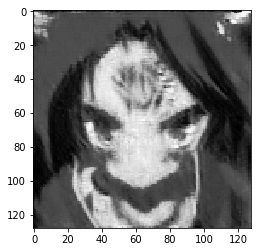

Estimate: [[ 3.72351766]]
Iteration: 44300 at 2018-01-09 11:46:05.539353


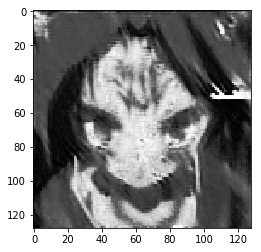

Estimate: [[ 41.41521454]]
Iteration: 44400 at 2018-01-09 11:48:02.123714


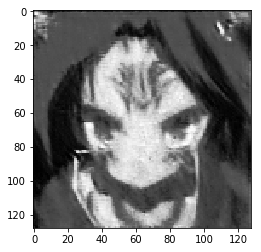

Estimate: [[-11.22368526]]
Iteration: 44500 at 2018-01-09 11:50:00.676080


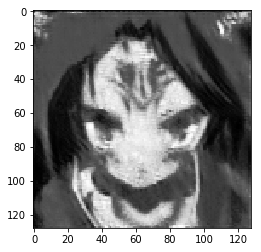

Estimate: [[-19.11907387]]
Iteration: 44600 at 2018-01-09 11:51:58.736924


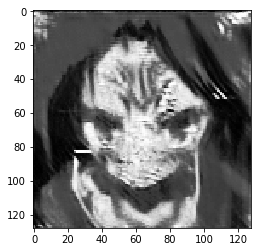

Estimate: [[-10.63351727]]
Iteration: 44700 at 2018-01-09 11:53:55.752057


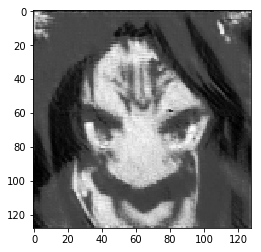

Estimate: [[ 0.98319817]]
Iteration: 44800 at 2018-01-09 11:55:54.330176


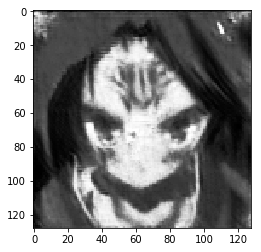

Estimate: [[ 2.32691669]]
Iteration: 44900 at 2018-01-09 11:57:50.216256


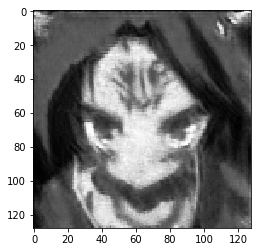

Estimate: [[ 12.97667885]]
Iteration: 45000 at 2018-01-09 11:59:48.497102


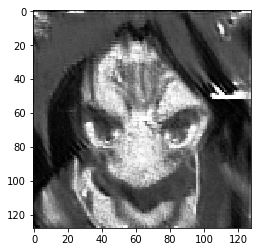

Estimate: [[-10.47768784]]
Iteration: 45100 at 2018-01-09 12:01:44.421623


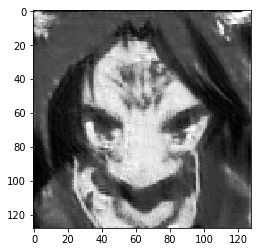

Estimate: [[ 0.3023133]]
Iteration: 45200 at 2018-01-09 12:03:42.860837


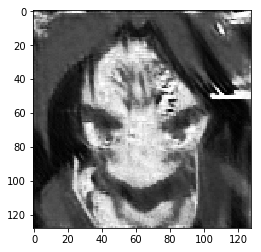

Estimate: [[ 23.75609589]]
Iteration: 45300 at 2018-01-09 12:05:40.311076


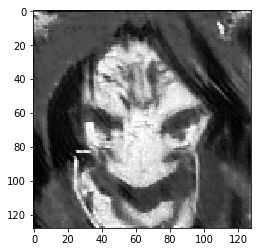

Estimate: [[-17.3007164]]
Iteration: 45400 at 2018-01-09 12:07:37.250817


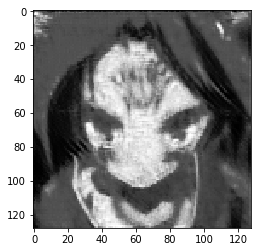

Estimate: [[ 13.62333965]]
Iteration: 45500 at 2018-01-09 12:09:34.843159


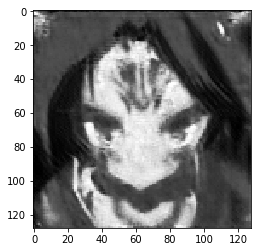

Estimate: [[-11.49332714]]
Iteration: 45600 at 2018-01-09 12:11:32.639122


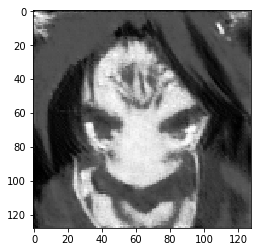

Estimate: [[-4.5976572]]
Iteration: 45700 at 2018-01-09 12:13:30.644787


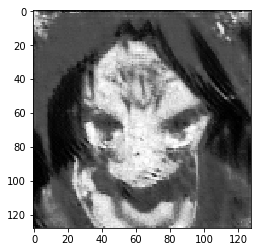

Estimate: [[-1.63609552]]
Iteration: 45800 at 2018-01-09 12:15:28.351944


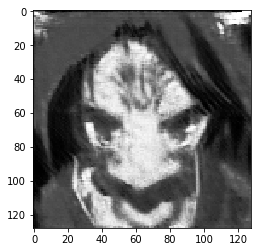

Estimate: [[-4.00037479]]
Iteration: 45900 at 2018-01-09 12:17:25.178389


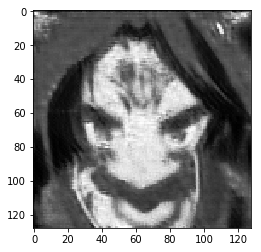

Estimate: [[-6.27847958]]
Iteration: 46000 at 2018-01-09 12:19:21.638278


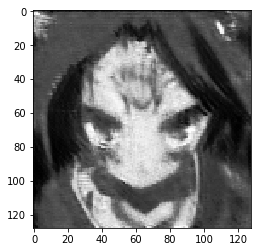

Estimate: [[-0.35954565]]
Iteration: 46100 at 2018-01-09 12:21:19.132503


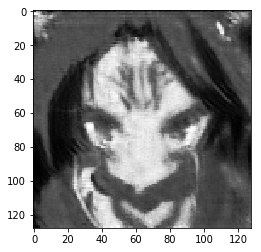

Estimate: [[-11.17176342]]
Iteration: 46200 at 2018-01-09 12:23:17.313909


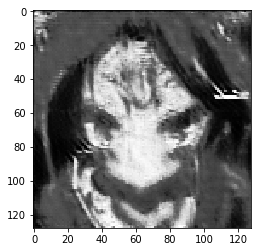

Estimate: [[-8.59323883]]
Iteration: 46300 at 2018-01-09 12:25:14.454927


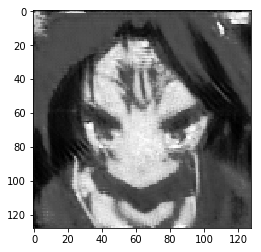

Estimate: [[-13.08760071]]
Iteration: 46400 at 2018-01-09 12:27:12.288606


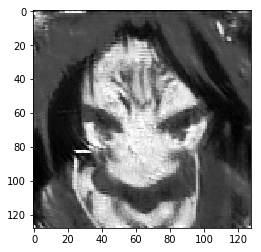

Estimate: [[ 3.35709906]]
Iteration: 46500 at 2018-01-09 12:29:09.278856


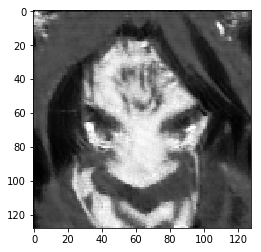

Estimate: [[ 4.17376041]]
Iteration: 46600 at 2018-01-09 12:31:06.157644


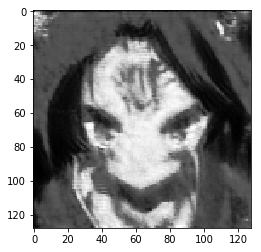

Estimate: [[-4.10715389]]
Iteration: 46700 at 2018-01-09 12:33:03.858882


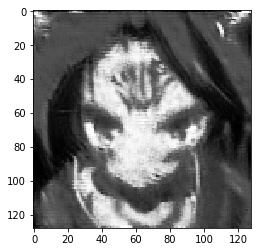

Estimate: [[-2.72152948]]
Iteration: 46800 at 2018-01-09 12:35:00.203572


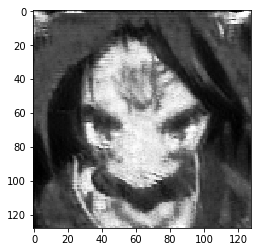

Estimate: [[ 2.53755713]]
Iteration: 46900 at 2018-01-09 12:36:58.018509


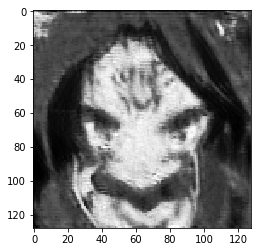

Estimate: [[-3.78135014]]
Iteration: 47000 at 2018-01-09 12:38:54.129988


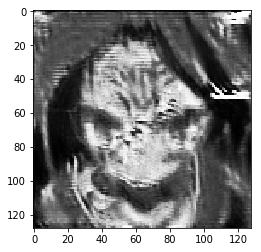

Estimate: [[ 5.66170931]]
Iteration: 47100 at 2018-01-09 12:40:52.804829


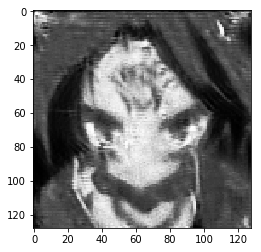

Estimate: [[ 6.04719162]]
Iteration: 47200 at 2018-01-09 12:42:49.942242


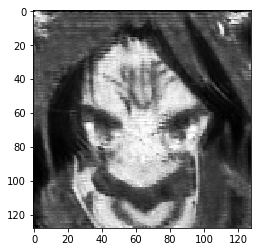

Estimate: [[ 6.44652796]]
Iteration: 47300 at 2018-01-09 12:44:47.359562


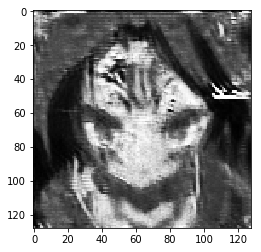

Estimate: [[-0.07682697]]
Iteration: 47400 at 2018-01-09 12:46:44.529971


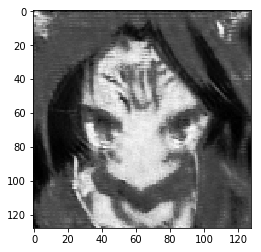

Estimate: [[-9.27821827]]
Iteration: 47500 at 2018-01-09 12:48:40.646029


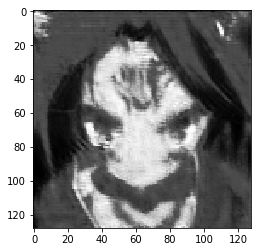

Estimate: [[-17.63507271]]
Iteration: 47600 at 2018-01-09 12:50:38.012099


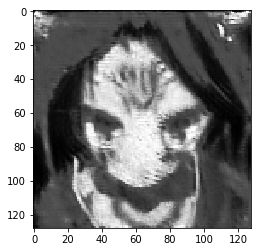

Estimate: [[-9.26938248]]
Iteration: 47700 at 2018-01-09 12:52:36.359636


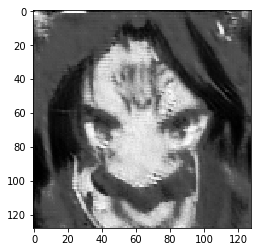

Estimate: [[-1.99869895]]
Iteration: 47800 at 2018-01-09 12:54:32.657641


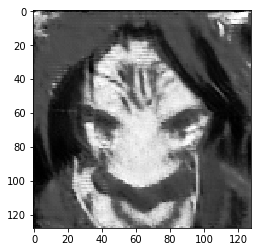

Estimate: [[-19.38818359]]
Iteration: 47900 at 2018-01-09 12:56:29.960957


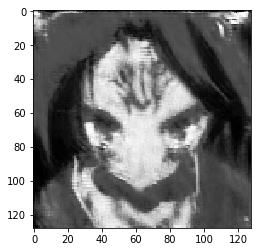

Estimate: [[-2.54749012]]
Iteration: 48000 at 2018-01-09 12:58:26.283824


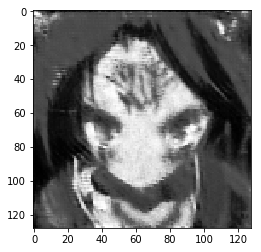

Estimate: [[ 3.78450465]]
Iteration: 48100 at 2018-01-09 13:00:24.442905


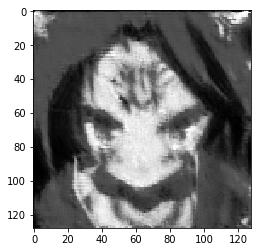

Estimate: [[ 4.56471586]]
Iteration: 48200 at 2018-01-09 13:02:21.825624


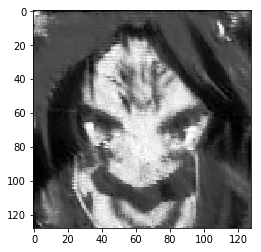

Estimate: [[ 7.40951586]]
Iteration: 48300 at 2018-01-09 13:04:20.291741


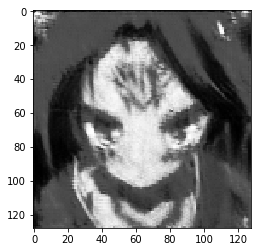

Estimate: [[-23.49913597]]
Iteration: 48400 at 2018-01-09 13:06:18.866242


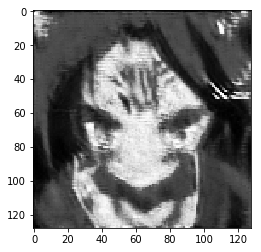

Estimate: [[-11.43789864]]
Iteration: 48500 at 2018-01-09 13:08:16.342479


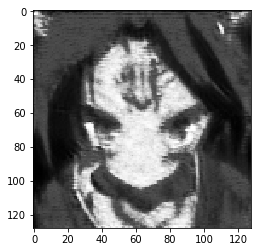

Estimate: [[-22.43353462]]
Iteration: 48600 at 2018-01-09 13:10:13.590122


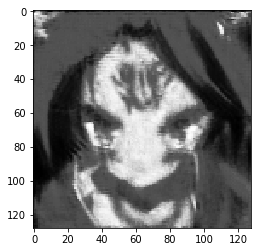

Estimate: [[-7.04131079]]


In [ ]:
sess = tf.Session()
sess.run(tf.global_variables_initializer())


# Pre-train discriminator
for i in range(300):
    z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])
    real_image_batch = sample_image.reshape([batch_size, img_height, img_width, 1])
    _, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],
                                           {x_placeholder: real_image_batch, z_placeholder: z_batch})

    if(i % 100 == 0):
        print("dLossReal:", dLossReal, "dLossFake:", dLossFake)

# Train generator and discriminator together
for i in range(100000):
    real_image_batch = sample_image.reshape([batch_size, img_height, img_width, 1])
    z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])

    # Train discriminator on both real and fake images
    _, __, dLossReal, dLossFake = sess.run([d_trainer_real, d_trainer_fake, d_loss_real, d_loss_fake],
                                           {x_placeholder: real_image_batch, z_placeholder: z_batch})

    # Train generator
    z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])
    _ = sess.run(g_trainer, feed_dict={z_placeholder: z_batch})

    if i % 10 == 0:
        # Update TensorBoard with summary statistics
        z_batch = np.random.normal(0, 1, size=[batch_size, z_dimensions])
        summary = sess.run(merged, {z_placeholder: z_batch, x_placeholder: real_image_batch})
        writer.add_summary(summary, i)

    if i % 100 == 0:
        # Every 100 iterations, show a generated image
        print("Iteration:", i, "at", datetime.datetime.now())
        z_batch = np.random.normal(0, 1, size=[1, z_dimensions])
        generated_images = generator(z_placeholder, 1, z_dimensions)
        images = sess.run(generated_images, {z_placeholder: z_batch})
        plt.imshow(images[0].reshape([img_height, img_width]), cmap="gray")
        plt.show()
        
        
        plt.imsave('XD/' + str(i)+'.png' , images[0].reshape([img_height, img_width]), cmap="gray")

        # Show discriminator's estimate
        im = images[0].reshape([1, img_height, img_width, 1])
        result = discriminator(x_placeholder)
        estimate = sess.run(result, {x_placeholder: im})
        print("Estimate:", estimate)